#### Import required packages  


In [85]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy

from pylab import rcParams
#import hdbscan

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

#### Read in cleaned  dataset from .csv file  

In [86]:
data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_02_task_02.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

del df_cluster['data_channel']

In [87]:

for column in ['LDA_00', 'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04']:
    new_col_name = 'ln_' + column
    print (new_col_name)
    df_cluster[new_col_name] = np.log(df_cluster[column]+1)


ln_LDA_00
ln_LDA_01
ln_LDA_02
ln_LDA_03
ln_LDA_04


In [88]:

col_names = df_cluster.columns.values.tolist()
col_names
df_cluster.describe().T



['n_tokens_title',
 'num_keywords',
 'kw_avg_max',
 'weekday_is_monday',
 'weekday_is_tuesday',
 'weekday_is_wednesday',
 'weekday_is_thursday',
 'weekday_is_friday',
 'is_weekend',
 'LDA_00',
 'LDA_01',
 'LDA_02',
 'LDA_03',
 'LDA_04',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'data_channel_n',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04']

,count,mean,std,min,25%,50%,75%,max
n_tokens_title,39644.0,10.398749,2.114037,2.0,9.000000,10.000000,12.000000,23.000000
num_keywords,39644.0,7.223767,1.909130,1.0,6.000000,7.000000,9.000000,10.000000
kw_avg_max,39644.0,1.913205,1.000000,0.0,1.271003,1.800325,2.442234,6.248298
weekday_is_monday,39644.0,0.168020,0.373889,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_tuesday,39644.0,0.186409,0.389441,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_wednesday,39644.0,0.187544,0.390353,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_thursday,39644.0,0.183306,0.386922,0.0,0.000000,0.000000,0.000000,1.000000
weekday_is_friday,39644.0,0.143805,0.350896,0.0,0.000000,0.000000,0.000000,1.000000
is_weekend,39644.0,0.130915,0.337312,0.0,0.000000,0.000000,0.000000,1.000000
LDA_00,39644.0,0.184599,0.262975,0.0,0.025051,0.033387,0.240958,0.926994


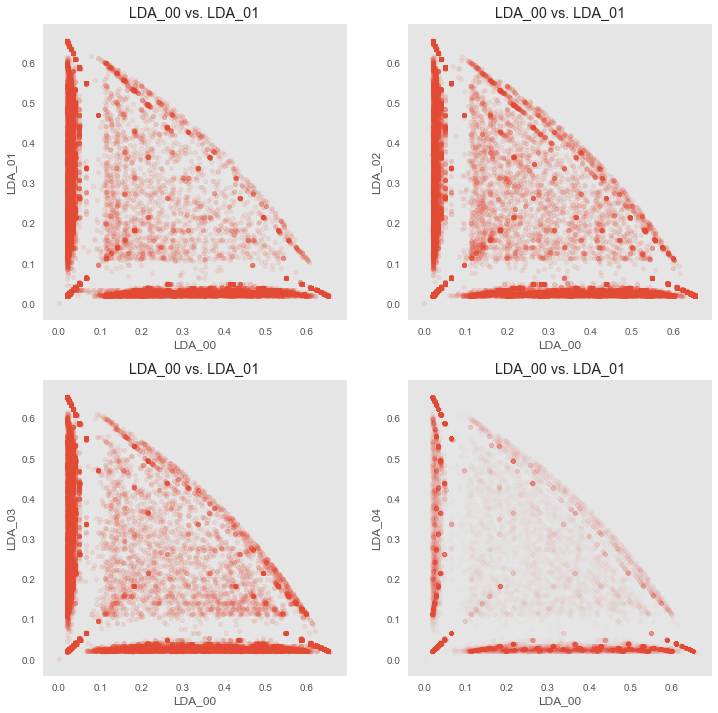

In [71]:
from matplotlib import pyplot as plt
plt.style.use("ggplot")

%matplotlib inline


X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']].values


plt.figure(figsize = (12,12))
plt.subplot(221)

plt.scatter(X1[:, 1], X1[:, 0],
            s = 20,
           alpha = 0.10)
plt.xlabel('LDA_00'), plt.ylabel('LDA_01')
plt.grid()
plt.title('LDA_00 vs. LDA_01')


plt.subplot(222)
plt.scatter(X1[:, 2], X1[:, 0],
            s = 20,
           alpha = 0.10)
plt.xlabel('LDA_00'), plt.ylabel('LDA_02')
plt.grid()
plt.title('LDA_00 vs. LDA_01')


plt.subplot(223)
plt.scatter(X1[:, 3], X1[:, 0],
            s = 20,
            alpha = 0.10)
plt.xlabel('LDA_00'), plt.ylabel('LDA_03')
plt.grid()
plt.title('LDA_00 vs. LDA_01')


plt.subplot(224)
plt.scatter(X1[:, 4], X1[:, 0],
            s = 20,
           alpha = 0.01)
plt.xlabel('LDA_00'), plt.ylabel('LDA_04')
plt.grid()
plt.title('LDA_00 vs. LDA_01')

plt.show();



### K-Means - LDA scores

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  2
inertia =  6016.62121709


(<matplotlib.text.Text at 0x7f9a86e06860>,
 <matplotlib.text.Text at 0x7f9a86de1e10>)

(<matplotlib.text.Text at 0x7f9a871740b8>,
 <matplotlib.text.Text at 0x7f9a87a83080>)

(<matplotlib.text.Text at 0x7f9a9cca9630>,
 <matplotlib.text.Text at 0x7f9a87d42e48>)

(<matplotlib.text.Text at 0x7f9a8717f1d0>,
 <matplotlib.text.Text at 0x7f9a8707a1d0>)

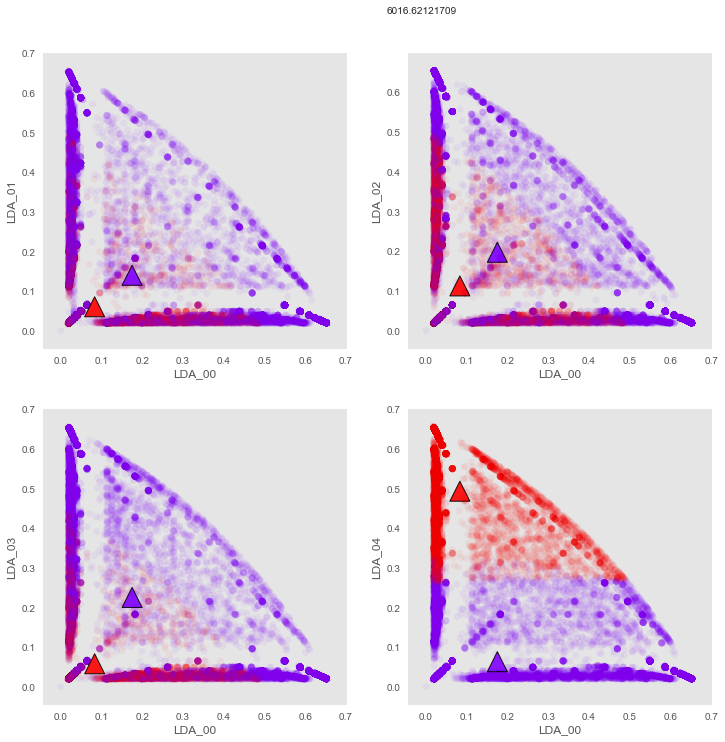

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  3
inertia =  4120.02063847


(<matplotlib.text.Text at 0x7f9a871aad68>,
 <matplotlib.text.Text at 0x7f9a87b91f98>)

(<matplotlib.text.Text at 0x7f9a871469b0>,
 <matplotlib.text.Text at 0x7f9a87028c50>)

(<matplotlib.text.Text at 0x7f9a874922b0>,
 <matplotlib.text.Text at 0x7f9a874b44e0>)

(<matplotlib.text.Text at 0x7f9a87951e48>,
 <matplotlib.text.Text at 0x7f9a872320b8>)

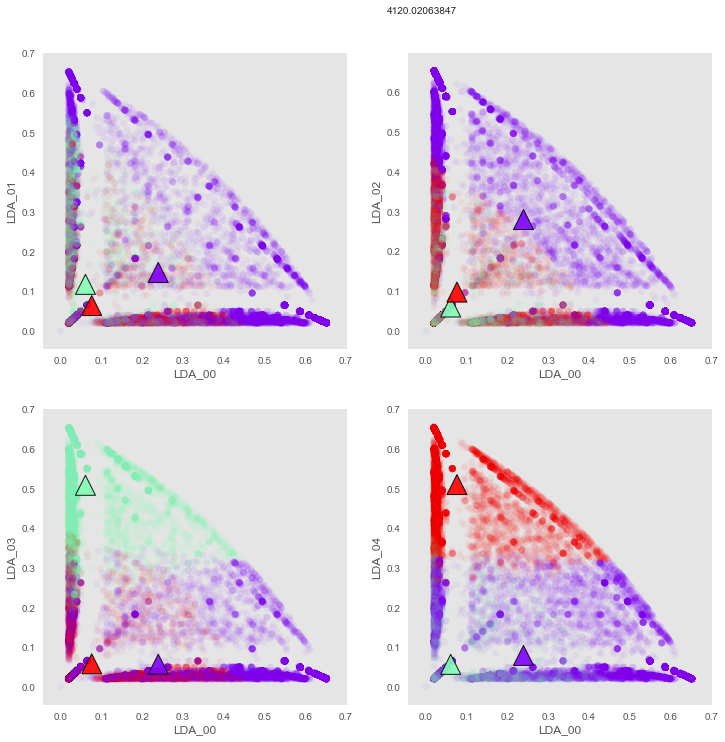

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  4
inertia =  2523.83403252


(<matplotlib.text.Text at 0x7f9aa7376dd8>,
 <matplotlib.text.Text at 0x7f9a8733fef0>)

(<matplotlib.text.Text at 0x7f9a8733f4a8>,
 <matplotlib.text.Text at 0x7f9a873a06a0>)

(<matplotlib.text.Text at 0x7f9a878ff8d0>,
 <matplotlib.text.Text at 0x7f9a878f1b00>)

(<matplotlib.text.Text at 0x7f9a86f354a8>,
 <matplotlib.text.Text at 0x7f9a86f036d8>)

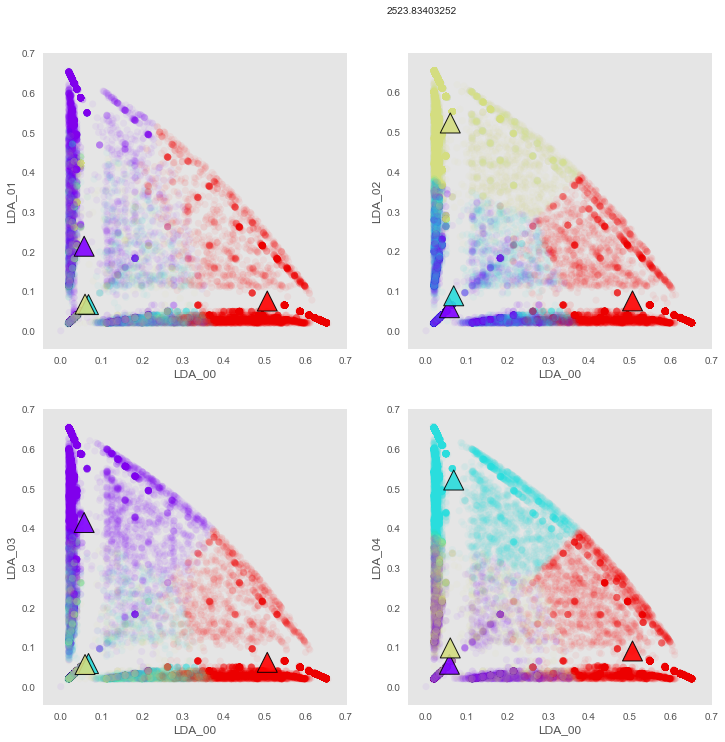

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  5
inertia =  1418.81957692


(<matplotlib.text.Text at 0x7f9a86e3a1d0>,
 <matplotlib.text.Text at 0x7f9a87327d68>)

(<matplotlib.text.Text at 0x7f9a8783a7b8>,
 <matplotlib.text.Text at 0x7f9a8750a128>)

(<matplotlib.text.Text at 0x7f9a86d9ceb8>,
 <matplotlib.text.Text at 0x7f9a87b5d160>)

(<matplotlib.text.Text at 0x7f9a876f6ac8>,
 <matplotlib.text.Text at 0x7f9a8786bcf8>)

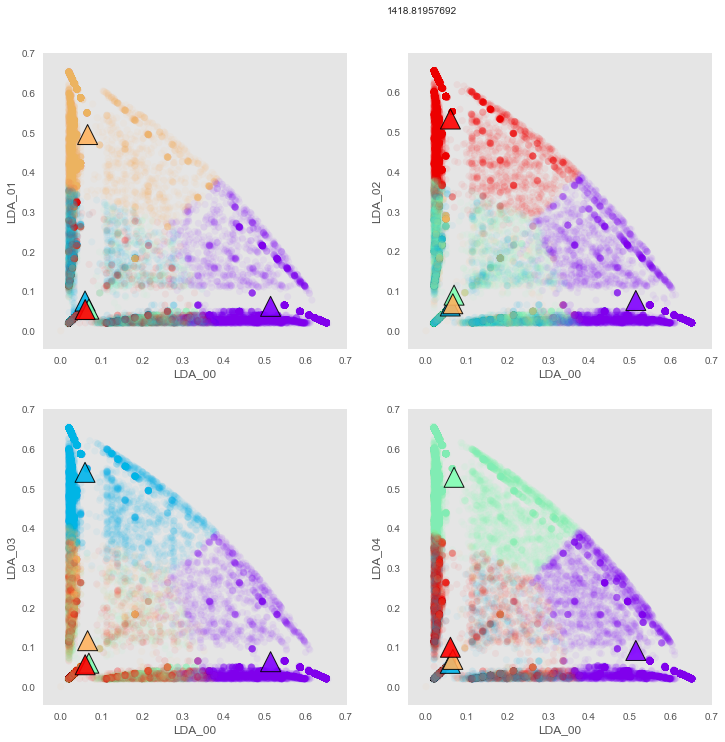

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  6
inertia =  1257.64273723


(<matplotlib.text.Text at 0x7f9a87b0abe0>,
 <matplotlib.text.Text at 0x7f9a872d8ef0>)

(<matplotlib.text.Text at 0x7f9a875e2438>,
 <matplotlib.text.Text at 0x7f9a87d76b70>)

(<matplotlib.text.Text at 0x7f9a87db0550>,
 <matplotlib.text.Text at 0x7f9a87d8a8d0>)

(<matplotlib.text.Text at 0x7f9a871c1128>,
 <matplotlib.text.Text at 0x7f9a871e5358>)

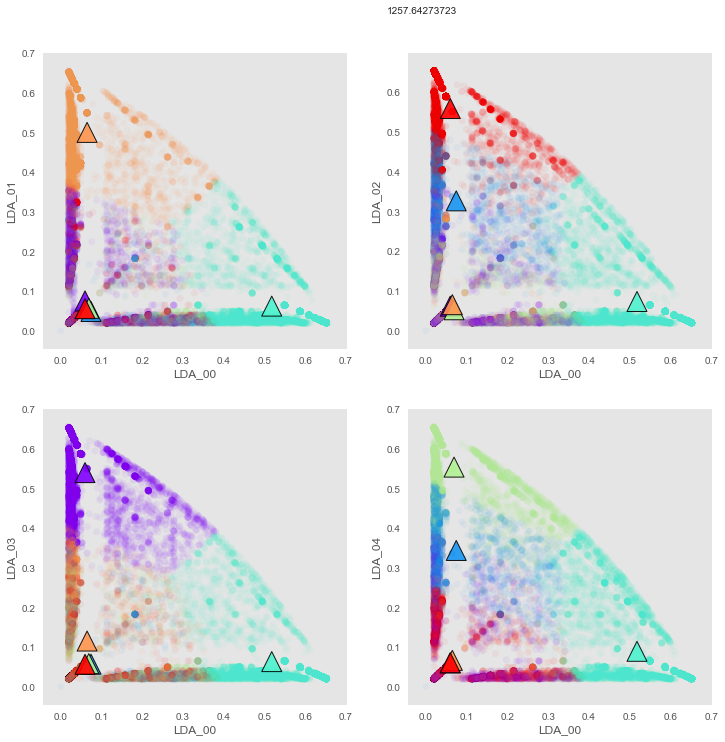

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  7
inertia =  1135.46696089


(<matplotlib.text.Text at 0x7f9a87700748>,
 <matplotlib.text.Text at 0x7f9a87d43d30>)

(<matplotlib.text.Text at 0x7f9a87b43eb8>,
 <matplotlib.text.Text at 0x7f9a87185358>)

(<matplotlib.text.Text at 0x7f9a872c5c50>,
 <matplotlib.text.Text at 0x7f9a87906cc0>)

(<matplotlib.text.Text at 0x7f9a872d8a58>,
 <matplotlib.text.Text at 0x7f9a86f04208>)

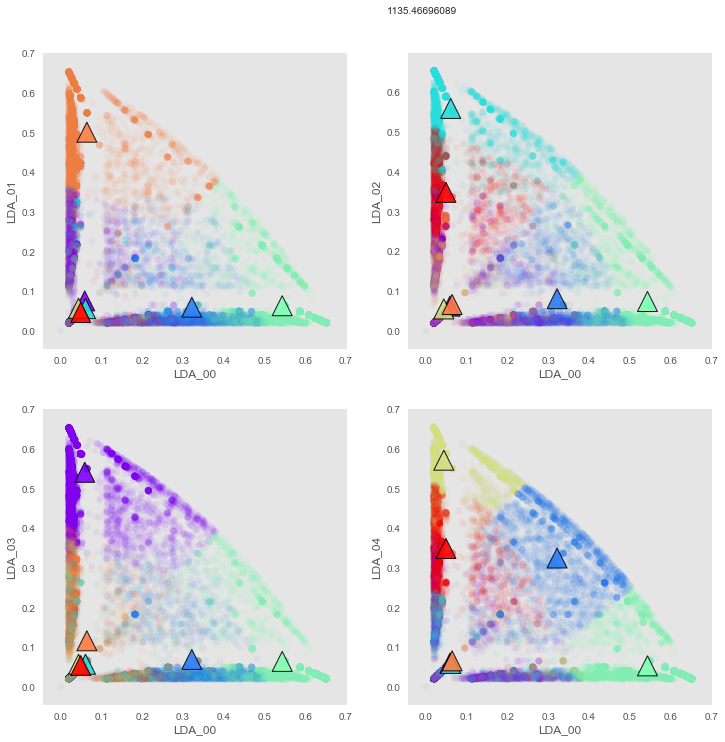

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  8
inertia =  1023.64621652


(<matplotlib.text.Text at 0x7f9aa7376048>,
 <matplotlib.text.Text at 0x7f9aa7493278>)

(<matplotlib.text.Text at 0x7f9a870a0c50>,
 <matplotlib.text.Text at 0x7f9a86e3a0b8>)

(<matplotlib.text.Text at 0x7f9a870585c0>,
 <matplotlib.text.Text at 0x7f9a86f58f60>)

(<matplotlib.text.Text at 0x7f9a86e6acc0>,
 <matplotlib.text.Text at 0x7f9a86e55ba8>)

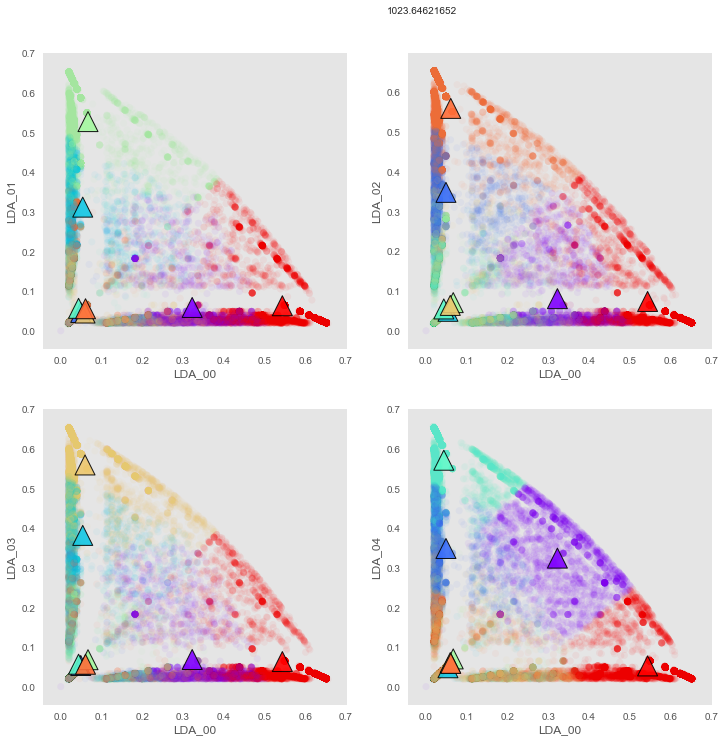

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  9
inertia =  937.873675896


(<matplotlib.text.Text at 0x7f9a87c9a9b0>,
 <matplotlib.text.Text at 0x7f9a9c805ba8>)

(<matplotlib.text.Text at 0x7f9a87014748>,
 <matplotlib.text.Text at 0x7f9a86fc6b38>)

(<matplotlib.text.Text at 0x7f9a87244940>,
 <matplotlib.text.Text at 0x7f9a87592518>)

(<matplotlib.text.Text at 0x7f9a87855518>,
 <matplotlib.text.Text at 0x7f9a86e22390>)

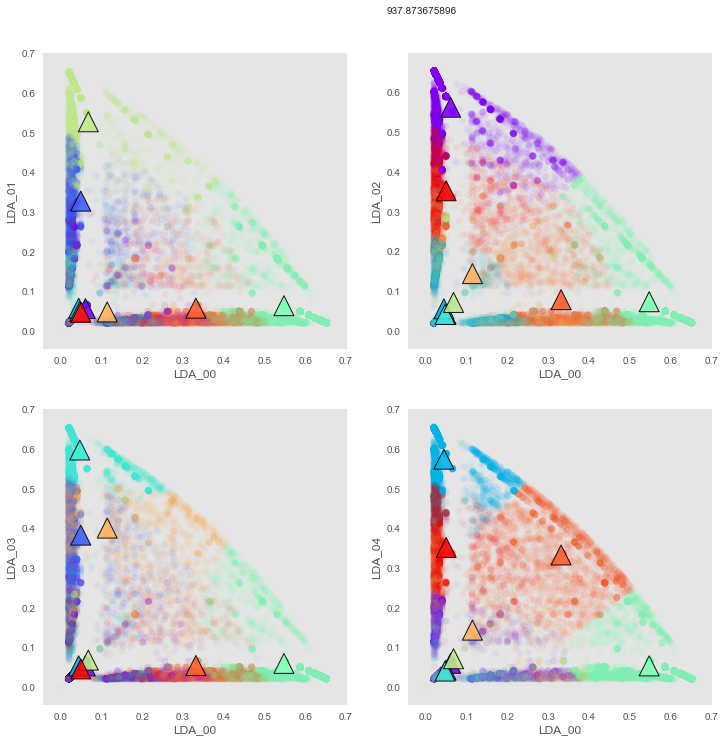

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  10
inertia =  859.164016267


(<matplotlib.text.Text at 0x7f9a87873c18>,
 <matplotlib.text.Text at 0x7f9a87817da0>)

(<matplotlib.text.Text at 0x7f9a87332550>,
 <matplotlib.text.Text at 0x7f9a879b3320>)

(<matplotlib.text.Text at 0x7f9a87959a58>,
 <matplotlib.text.Text at 0x7f9a879f3c88>)

(<matplotlib.text.Text at 0x7f9a87a85630>,
 <matplotlib.text.Text at 0x7f9a873bf860>)

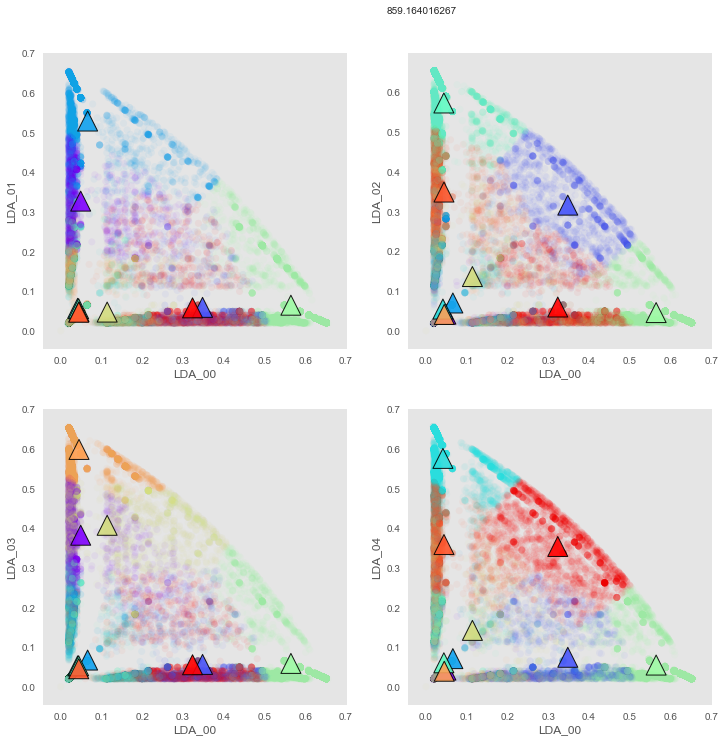

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  11
inertia =  794.23042098


(<matplotlib.text.Text at 0x7f9a86d765c0>,
 <matplotlib.text.Text at 0x7f9a87a1f7f0>)

(<matplotlib.text.Text at 0x7f9a875900b8>,
 <matplotlib.text.Text at 0x7f9a875bacf8>)

(<matplotlib.text.Text at 0x7f9a8774d0b8>,
 <matplotlib.text.Text at 0x7f9a877572e8>)

(<matplotlib.text.Text at 0x7f9a86aeac50>,
 <matplotlib.text.Text at 0x7f9a86ad6e80>)

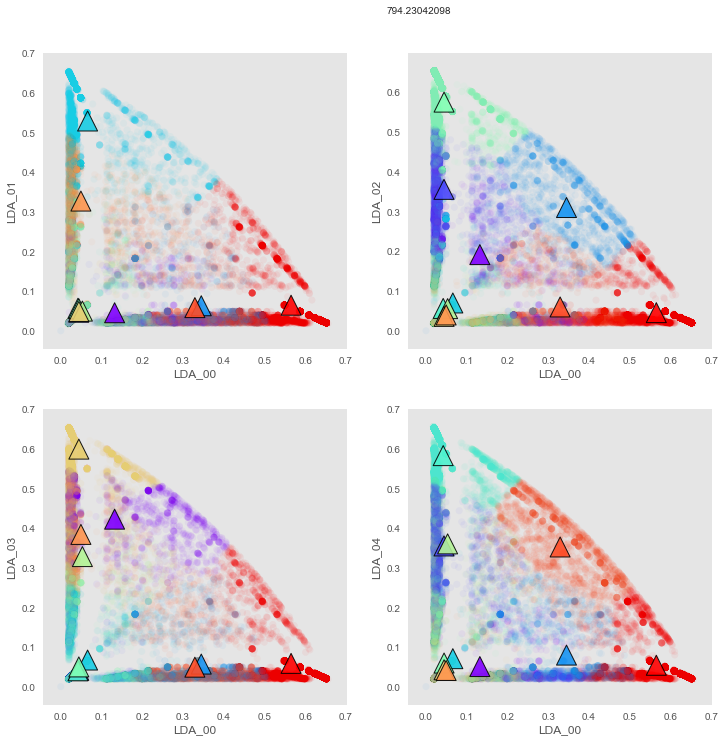

In [68]:


for n_lda in range(2, 12):        

    X1 = df_cluster[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1)
    
    cls_lda.fit(X1)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_
    kmeans_inertia = cls_lda.inertia_
    
    print ("n_lda = ", n_lda)
    print ("inertia = ", kmeans_inertia)

    plt.figure(figsize=(12, 12));
    plt.subplot(221);
    X1 = X1.values;
    plt.scatter(X1[:, 0], X1[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.text(0.8, 0.8,
             kmeans_inertia)
    
    plt.xlabel('LDA_00'), plt.ylabel('LDA_01');
    plt.grid();

    plt.subplot(222);
    plt.scatter(X1[:, 0], X1[:, 2],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 2],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('LDA_00'), plt.ylabel('LDA_02');
    plt.grid();

    plt.subplot(223);
    plt.scatter(X1[:, 0], X1[:, 3],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 3],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('LDA_00'), plt.ylabel('LDA_03');
    plt.grid();

    plt.subplot(224);
    plt.scatter(X1[:, 0], X1[:, 4],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 4],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('LDA_00'), plt.ylabel('LDA_04');
    plt.grid();

    plt.show();


### K-Means - images & videos  


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  2
inertia =  49187.3739481


(<matplotlib.text.Text at 0x7f9a869f96a0>,
 <matplotlib.text.Text at 0x7f9a86ed46a0>)

(<matplotlib.text.Text at 0x7f9a869b1080>,
 <matplotlib.text.Text at 0x7f9a87397eb8>)

(<matplotlib.text.Text at 0x7f9a868e40b8>,
 <matplotlib.text.Text at 0x7f9a867b3358>)

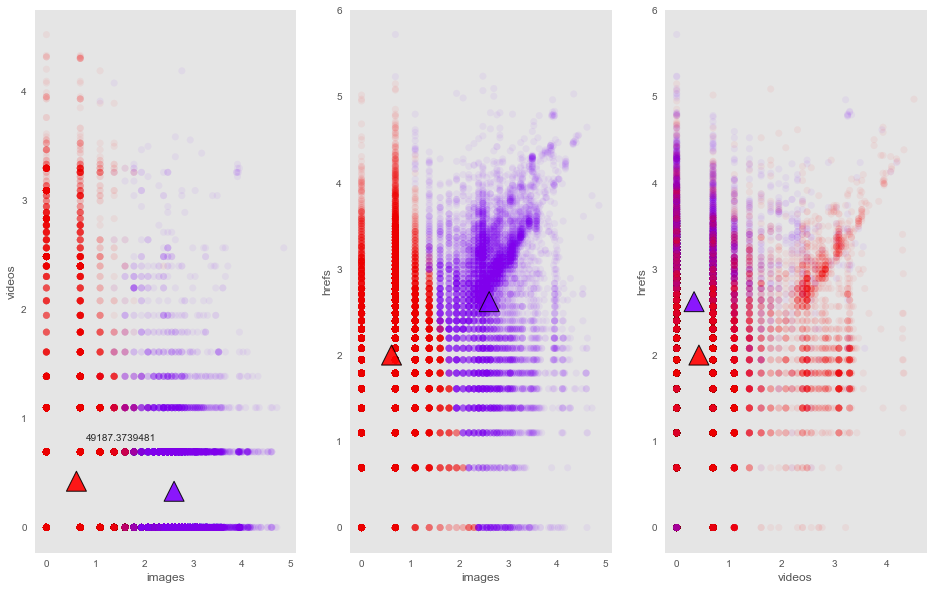

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  3
inertia =  37625.0279826


(<matplotlib.text.Text at 0x7f9a8678e2b0>,
 <matplotlib.text.Text at 0x7f9a87c9aef0>)

(<matplotlib.text.Text at 0x7f9a86dbcdd8>,
 <matplotlib.text.Text at 0x7f9a86903208>)

(<matplotlib.text.Text at 0x7f9a8709e828>,
 <matplotlib.text.Text at 0x7f9a9d257160>)

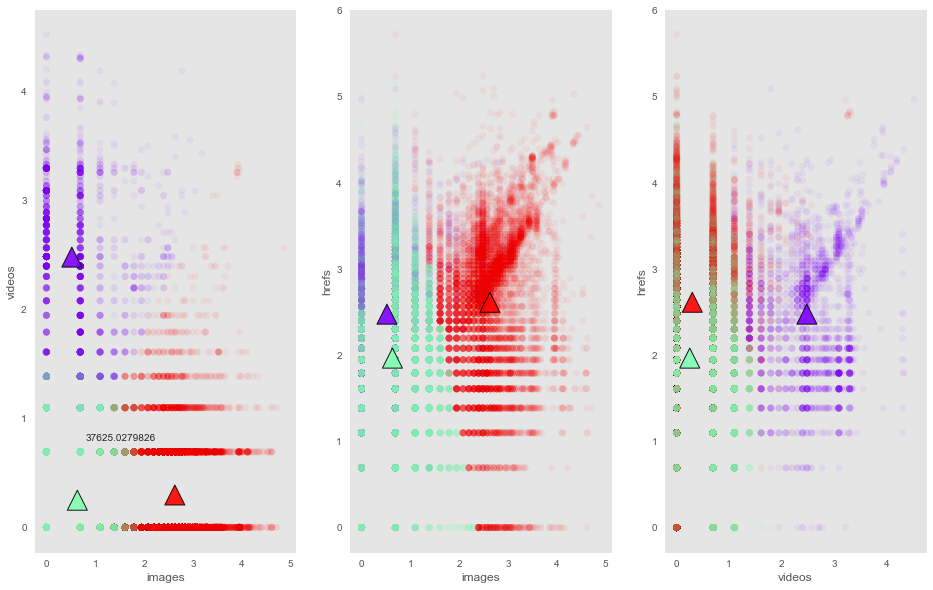

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  4
inertia =  28917.9668688


(<matplotlib.text.Text at 0x7f9a866462e8>,
 <matplotlib.text.Text at 0x7f9a87b1c198>)

(<matplotlib.text.Text at 0x7f9a865abb38>,
 <matplotlib.text.Text at 0x7f9a87986fd0>)

(<matplotlib.text.Text at 0x7f9a879fd978>,
 <matplotlib.text.Text at 0x7f9a8739fba8>)

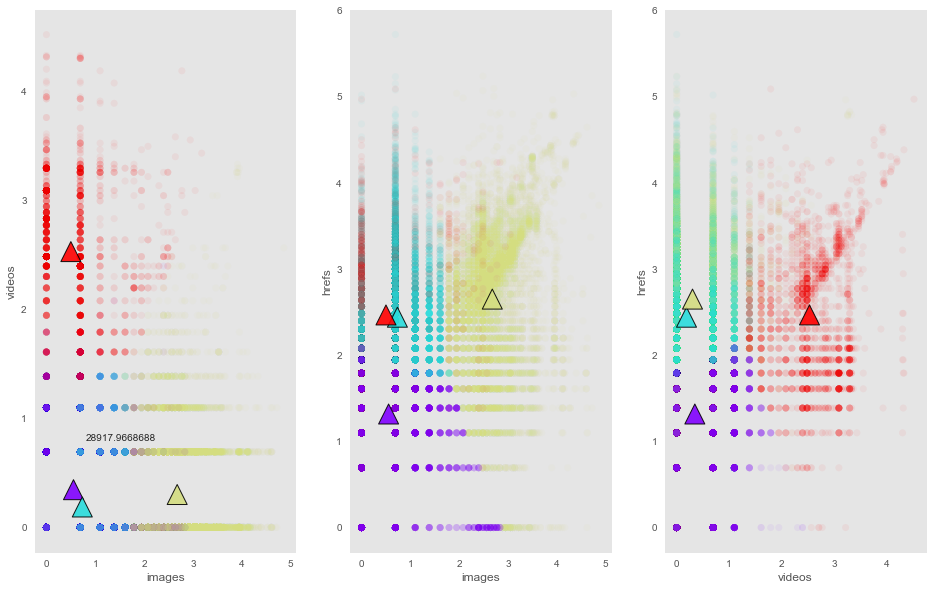

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  5
inertia =  24309.3293114


(<matplotlib.text.Text at 0x7f9a871d0da0>,
 <matplotlib.text.Text at 0x7f9a8676ecc0>)

(<matplotlib.text.Text at 0x7f9a87b493c8>,
 <matplotlib.text.Text at 0x7f9a87795320>)

(<matplotlib.text.Text at 0x7f9a87b1b438>,
 <matplotlib.text.Text at 0x7f9a86d9d668>)

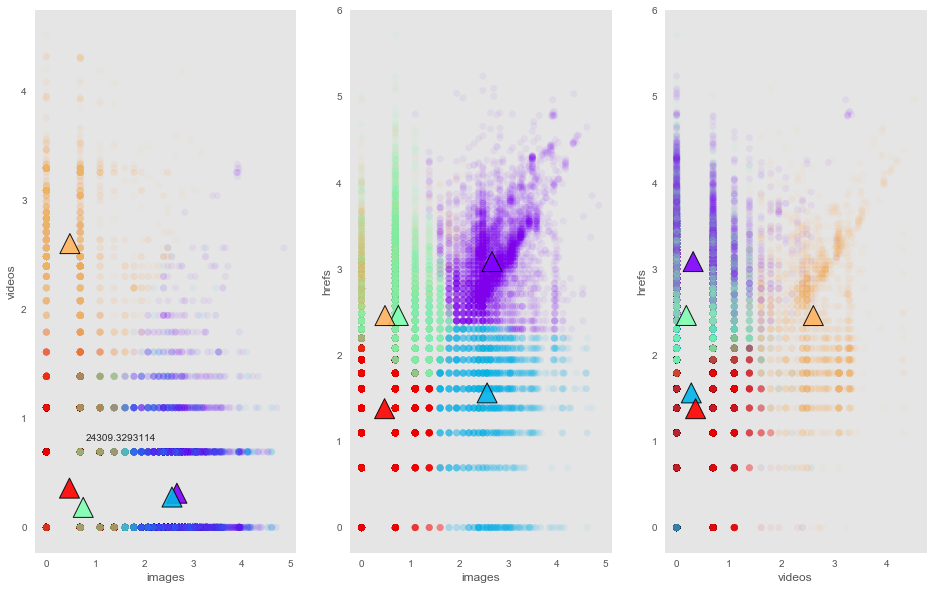

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  6
inertia =  21231.9882546


(<matplotlib.text.Text at 0x7f9a873ec630>,
 <matplotlib.text.Text at 0x7f9a8786cc50>)

(<matplotlib.text.Text at 0x7f9a87139be0>,
 <matplotlib.text.Text at 0x7f9a87110400>)

(<matplotlib.text.Text at 0x7f9a876fcc50>,
 <matplotlib.text.Text at 0x7f9a87245e80>)

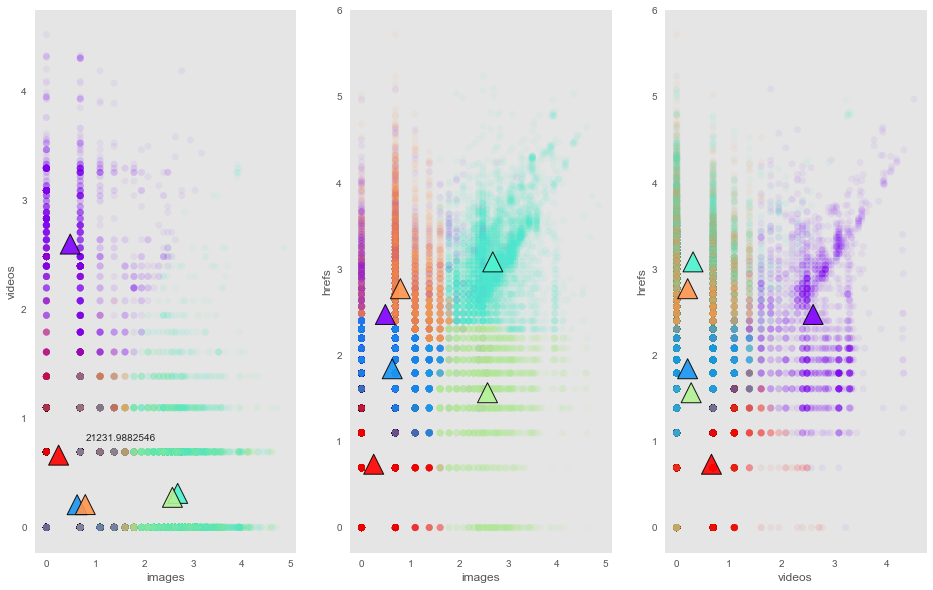

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  7
inertia =  18723.7392632


(<matplotlib.text.Text at 0x7f9a875009e8>,
 <matplotlib.text.Text at 0x7f9a877c7438>)

(<matplotlib.text.Text at 0x7f9a8760e6a0>,
 <matplotlib.text.Text at 0x7f9a877e9e10>)

(<matplotlib.text.Text at 0x7f9a87af7710>,
 <matplotlib.text.Text at 0x7f9a87ad5940>)

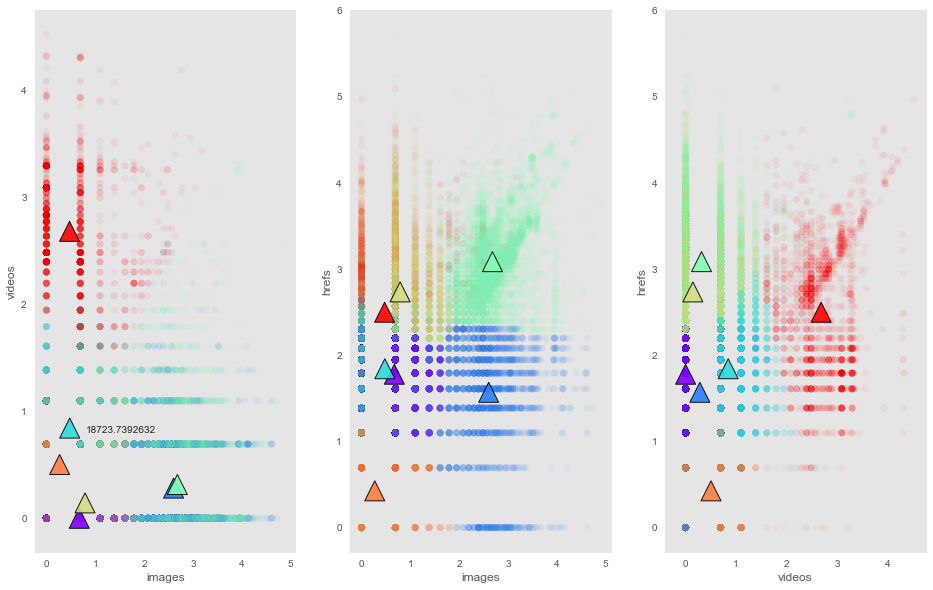

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  8
inertia =  17210.2410622


(<matplotlib.text.Text at 0x7f9a87d98b38>,
 <matplotlib.text.Text at 0x7f9a866c6c88>)

(<matplotlib.text.Text at 0x7f9a865252e8>,
 <matplotlib.text.Text at 0x7f9a866e7908>)

(<matplotlib.text.Text at 0x7f9a8662d518>,
 <matplotlib.text.Text at 0x7f9a86406748>)

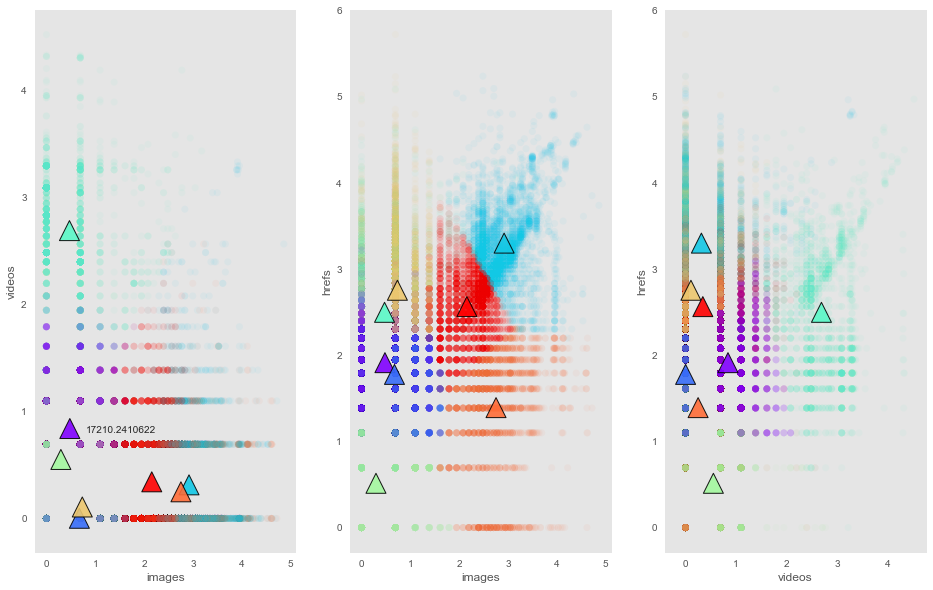

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda =  9
inertia =  15960.0254427


(<matplotlib.text.Text at 0x7f9a8639fe10>,
 <matplotlib.text.Text at 0x7f9a86357d30>)

(<matplotlib.text.Text at 0x7f9a862c2208>,
 <matplotlib.text.Text at 0x7f9a8662b208>)

(<matplotlib.text.Text at 0x7f9a862b43c8>,
 <matplotlib.text.Text at 0x7f9a86244668>)

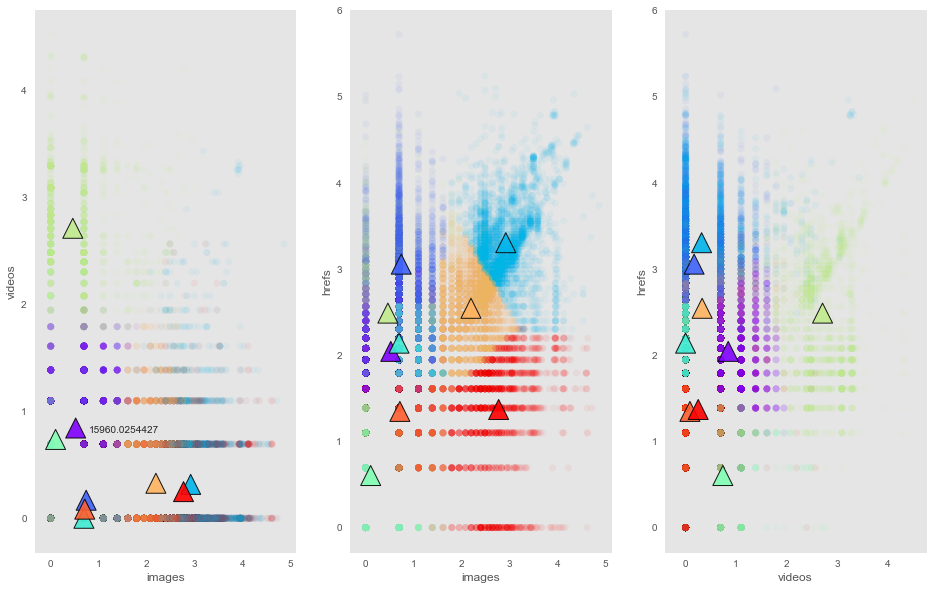

In [75]:

for n_lda in range(2, 10):        

    X1 = df_cluster[['ln_num_imgs','ln_num_videos', 'ln_num_hrefs']] 

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1)
    
    cls_lda.fit(X1)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_
    kmeans_inertia = cls_lda.inertia_
    
    print ("n_lda = ", n_lda)
    print ("inertia = ", kmeans_inertia)

    plt.figure(figsize = (16, 8));
    
    plt.subplot(131);
    X1 = X1.values;
    plt.scatter(X1[:, 0], X1[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.text(0.8, 0.8,
             kmeans_inertia)
    plt.xlabel('images'), plt.ylabel('videos');
    plt.grid();

    plt.subplot(132);
    plt.scatter(X1[:, 0], X1[:, 2],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 2],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('images'), plt.ylabel('hrefs');
    plt.grid();

    plt.subplot(133);
    plt.scatter(X1[:, 1], X1[:, 2],
                c = kmeans_labels,
                cmap = plt.cm.rainbow,
                s = 50,
                linewidths = 0,
                alpha = 0.05);
    plt.scatter(kmeans_centers[:, 1], kmeans_centers[:, 2],
                c = range(n_lda),
                cmap = plt.cm.rainbow,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    plt.xlabel('videos'), plt.ylabel('hrefs');
    plt.grid();

    plt.show();


### K-Means - All in  


In [92]:

X1 = df_cluster

for n_lda in range(2, 50):
    
    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    cls_lda.fit(X1);

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_
    kmeans_inertia = cls_lda.inertia_
    
    print ("n_lda, inertia ", n_lda, kmeans_inertia)



KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  2 1400523.17552


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  3 1144630.43362


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  4 999391.40361


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  5 920707.821029


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  6 865749.225149


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  7 826467.6524


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  8 790950.316967


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  9 760728.643599


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  10 737976.545004


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  11 707754.988617


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=12, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  12 690898.002824


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=13, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  13 672954.033663


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=14, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  14 654187.355961


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=15, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  15 636575.197943


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=16, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  16 624657.912653


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=17, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  17 607352.4059


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=18, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  18 593595.16628


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=19, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  19 580116.824736


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=20, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  20 570068.078441


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=21, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  21 562781.834665


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=22, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  22 552623.583665


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=23, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  23 545386.824391


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=24, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  24 537545.642193


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=25, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  25 530416.198054


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=26, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  26 525308.444554


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=27, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  27 518818.017372


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=28, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  28 512876.386609


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=29, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  29 506872.446699


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=30, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  30 504472.916189


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=31, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  31 496877.438534


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=32, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  32 495499.727361


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=33, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  33 488749.800276


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=34, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  34 485194.04255


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=35, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  35 479811.704958


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=36, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  36 475947.600044


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=37, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  37 474888.349668


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=38, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  38 469569.026596


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=39, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  39 466151.295081


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=40, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  40 461745.122564


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=41, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  41 459225.535709


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=42, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  42 456087.705501


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=43, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  43 453530.110481


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=44, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  44 448340.223627


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=45, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  45 447643.876847


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=46, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  46 444153.308176


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=47, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  47 441235.127152


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=48, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  48 436945.420468


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=49, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

n_lda, inertia  49 436473.318796


### DBSCAN


http://hdbscan.readthedocs.io/en/latest/comparing_clustering_algorithms.html  

DBSCAN is a density based algorithm – it assumes clusters for dense regions. It is also the first actual clustering algorithm we’ve looked at: it doesn’t require that every point be assigned to a cluster and hence doesn’t partition the data, but instead extracts the ‘dense’ clusters and leaves sparse background classified as ‘noise’.  
In practice DBSCAN is related to agglomerative clustering.  
As a first step DBSCAN transforms the space according to the density of the data: points in dense regions are left alone, while points in sparse regions are moved further away. Applying single linkage clustering to the transformed space results in a dendrogram, which we cut according to a distance parameter (called epsilon or eps in many implementations) to get clusters. Importantly any singleton clusters at that cut level are deemed to be ‘noise’ and left unclustered. This provides several advantages: we get the manifold following behaviour of agglomerative clustering, and we get actual clustering as opposed to partitioning. Better yet, since we can frame the algorithm in terms of local region queries we can use various tricks such as kdtrees to get exceptionally good performance and scale to dataset sizes that are otherwise unapproachable with algorithms other than K-Means.  
There are some catches however. Obviously epsilon can be hard to pick; you can do some data analysis and get a good guess, but the algorithm can be quite sensitive to the choice of the parameter. The density based transformation depends on another parameter (min_samples in sklearn).  
Finally the combination of min_samples and eps amounts to a choice of density and the clustering only finds clusters at or above that density; if your data has variable density clusters then DBSCAN is either going to miss them, split them up, or lump some of them together depending on your parameter choices.  

So, in summary:  

   - __Don’t be wrong!__: Clusters don’t need to be globular, and won’t have noise lumped in; varying density clusters may cause problems, but that is more in the form of insufficient detail rather than explicitly wrong. DBSCAN is the first clustering algorithm we’ve looked at that actually meets the ‘Don’t be wrong!’ requirement.  
    - __Intuitive parameters__: Epsilon is a distance value, so you can survey the distribution of distances in your dataset to attempt to get an idea of where it should lie. In practice, however, this isn’t an especially intuitive parameter, nor is it easy to get right.  
    - __Stability__: DBSCAN is stable across runs (and to some extent subsampling if you re-parameterize well); stability over varying epsilon and min samples is not so good.  
    - __Performance__: This is DBSCAN’s other great strength; few clustering algorithms can tackle datasets as large as DBSCAN can.  

So how does it cluster our test dataset? I played with a few epsilon values until I got somethign reasonable, but there was little science to this – getting the parameters right can be hard.  

eps, min_pts =  0.005 20


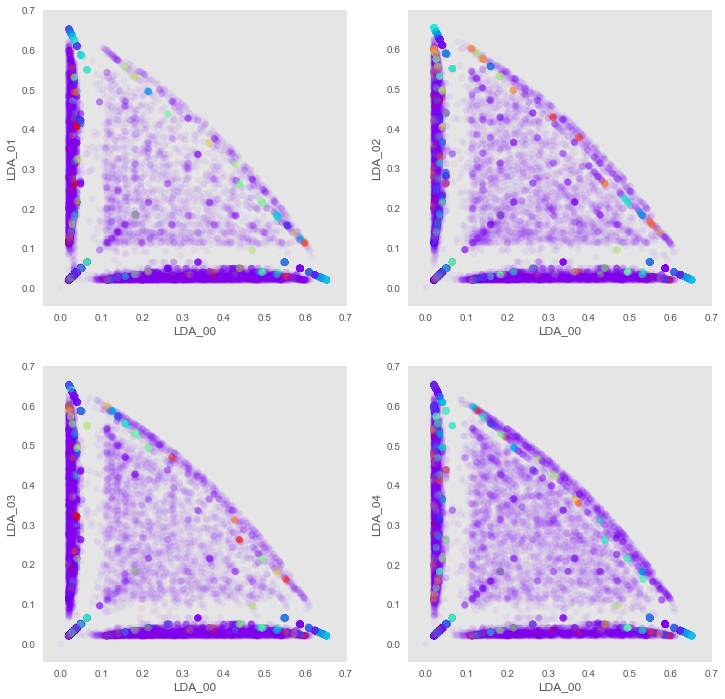

eps, min_pts =  0.005 40


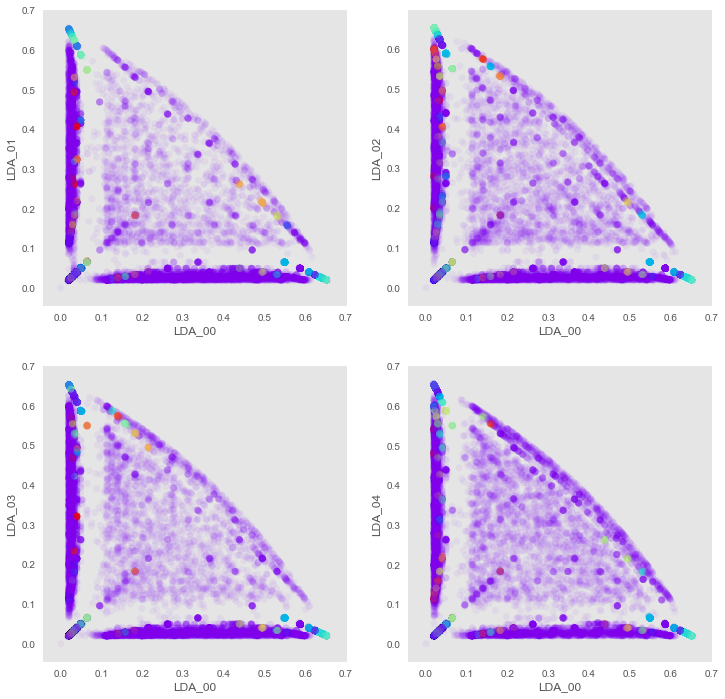

eps, min_pts =  0.005 60


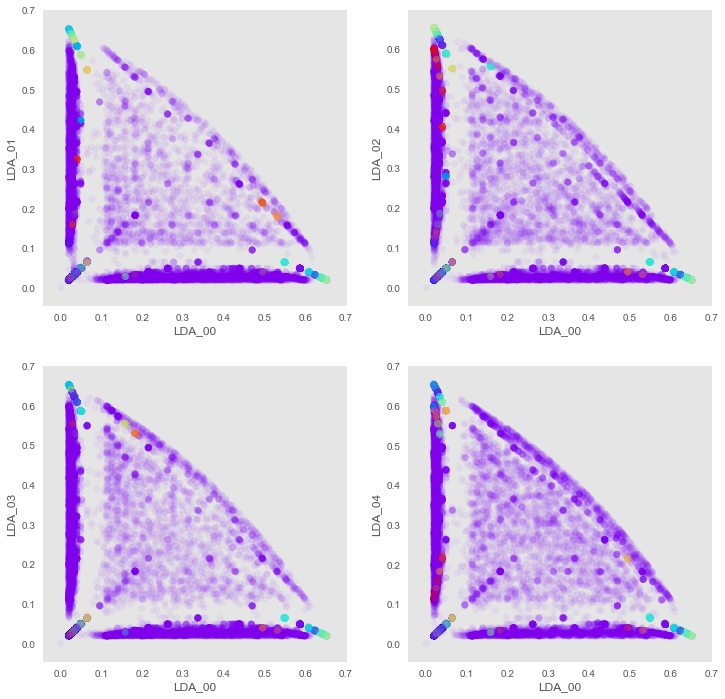

eps, min_pts =  0.005 80


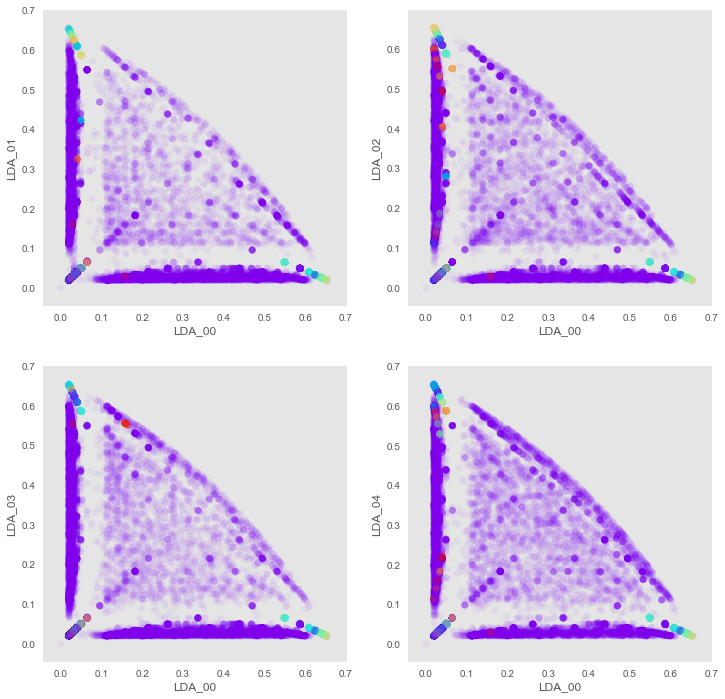

eps, min_pts =  0.005 100


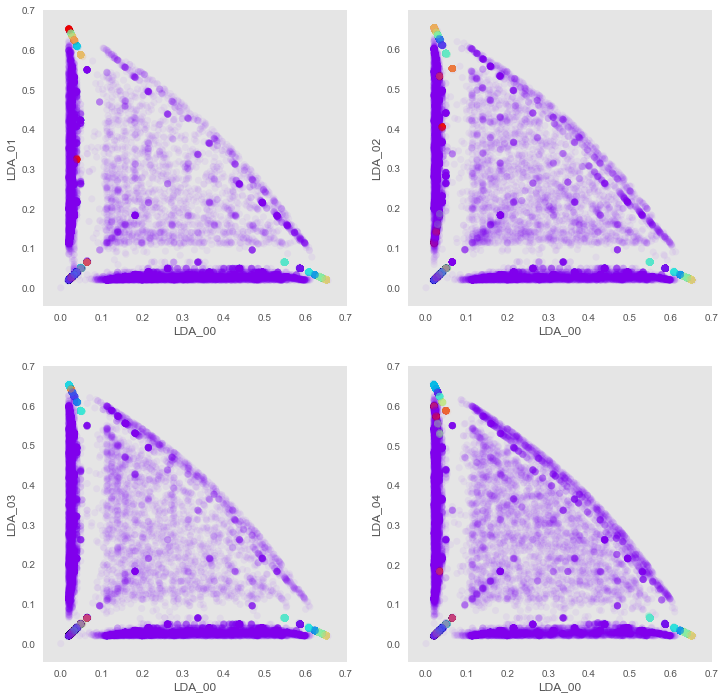

eps, min_pts =  0.005 120


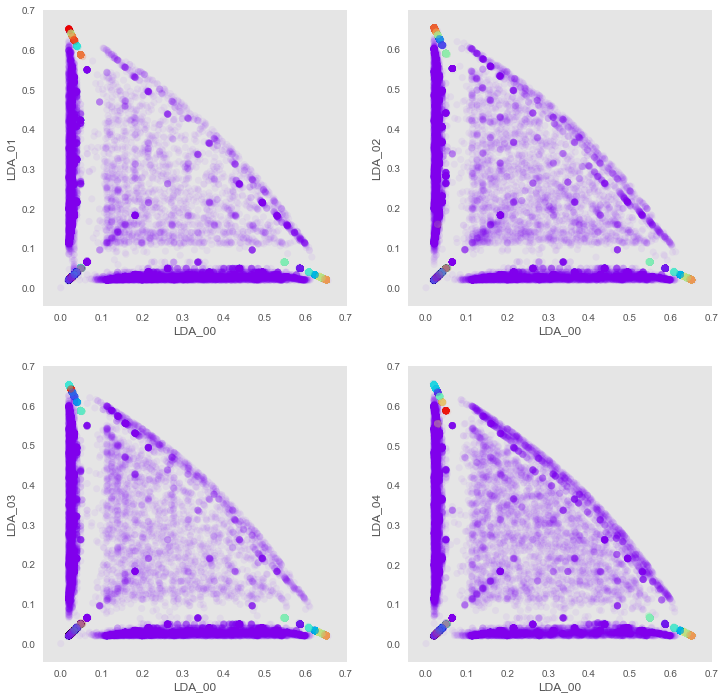

eps, min_pts =  0.005 140


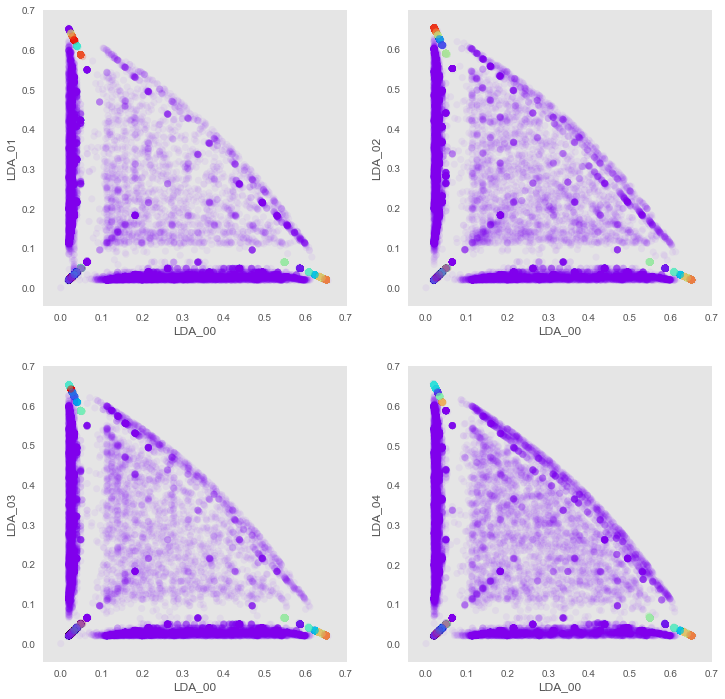

eps, min_pts =  0.005 160


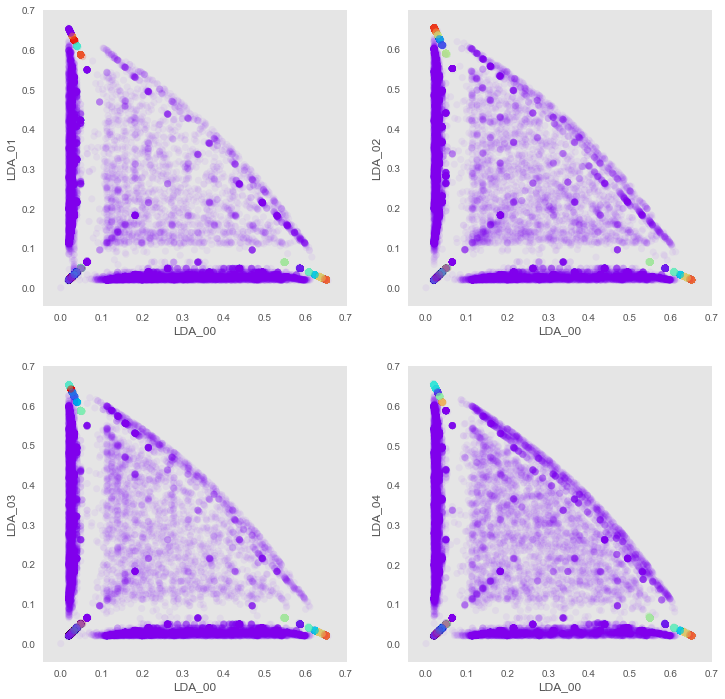

eps, min_pts =  0.005 180


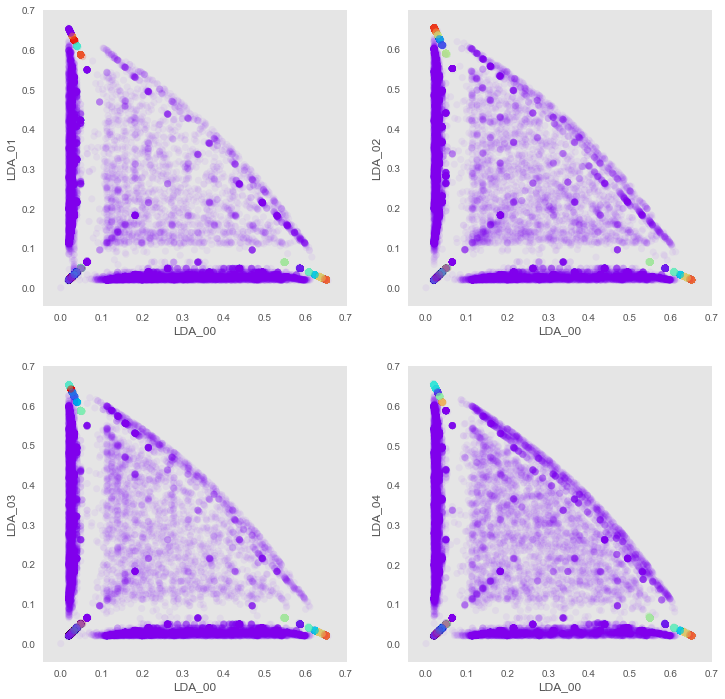

eps, min_pts =  0.0075 20


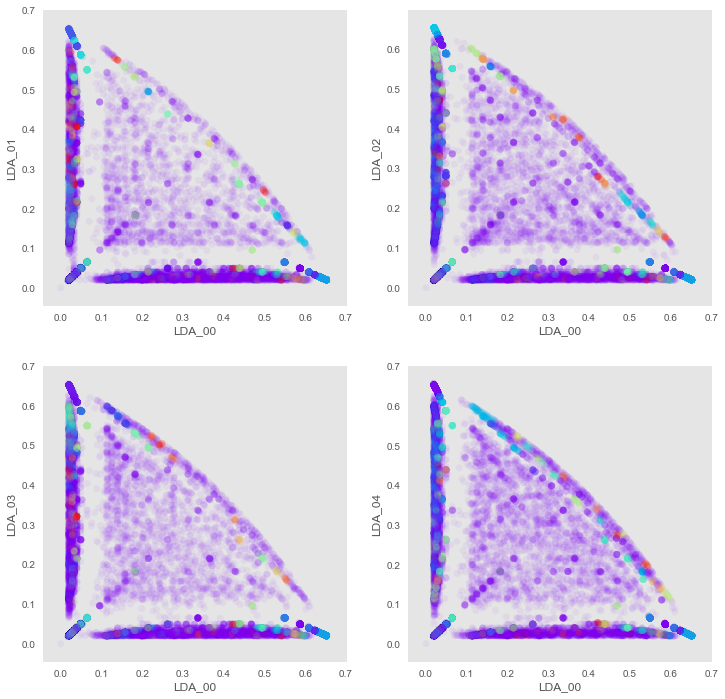

eps, min_pts =  0.0075 40


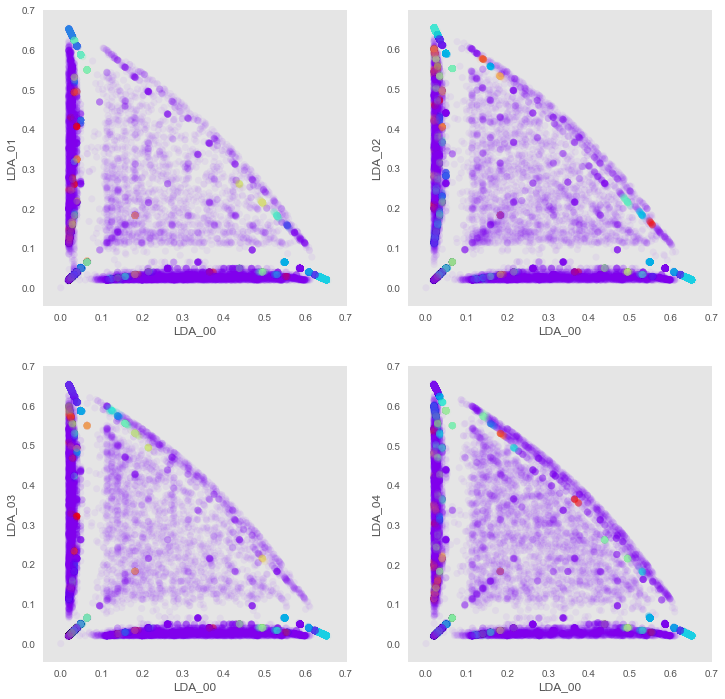

eps, min_pts =  0.0075 60


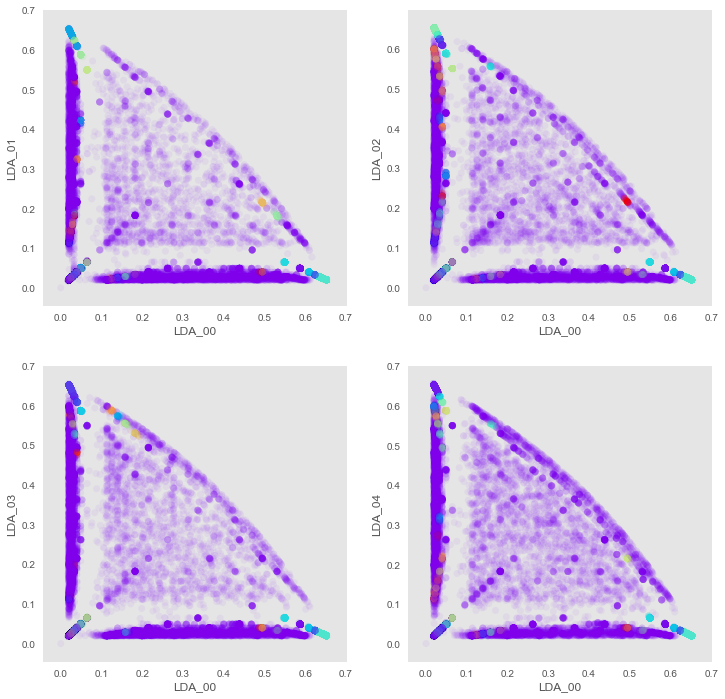

eps, min_pts =  0.0075 80


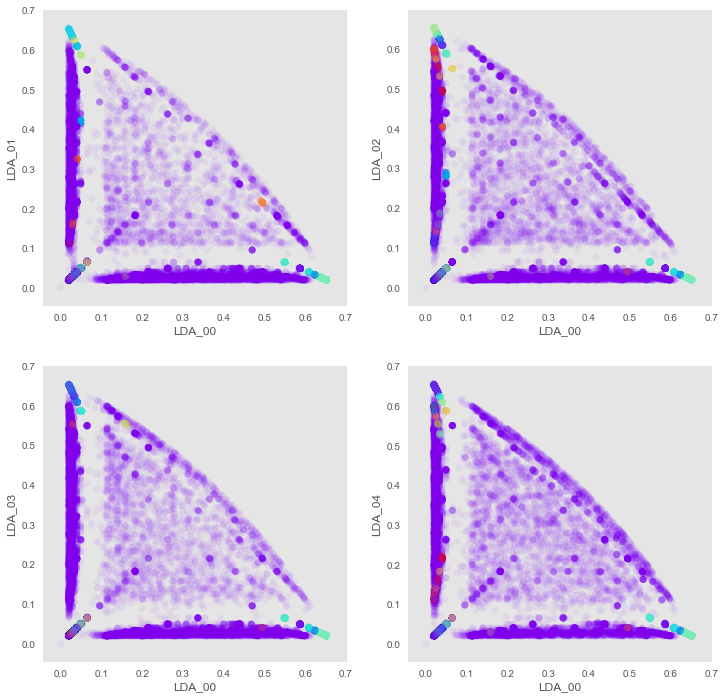

eps, min_pts =  0.0075 100


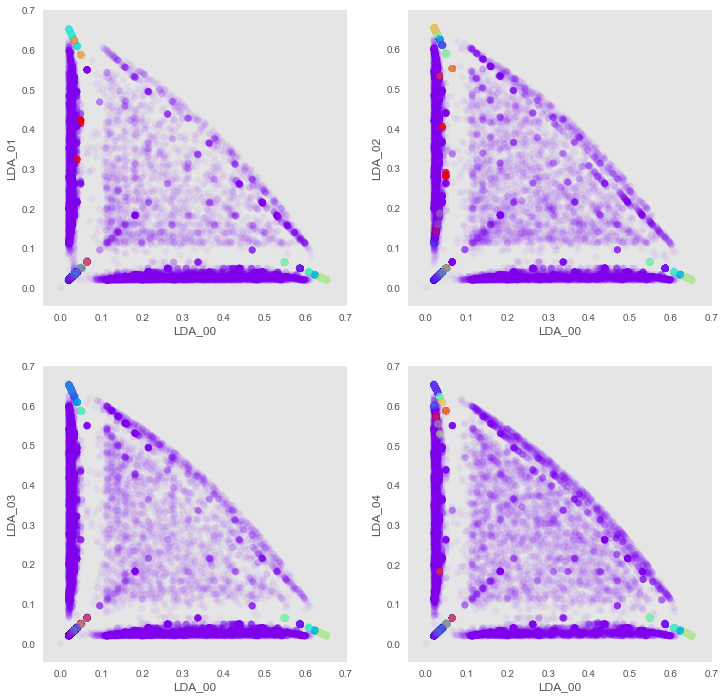

eps, min_pts =  0.0075 120


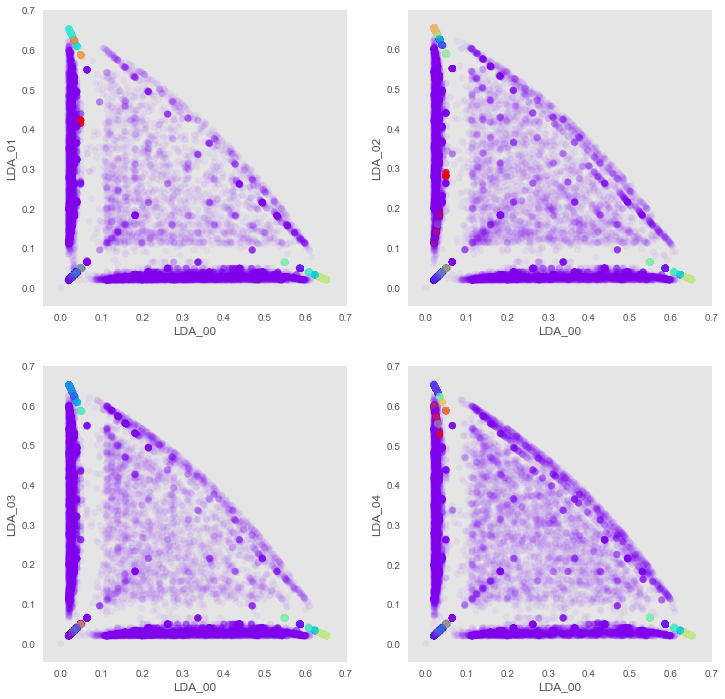

eps, min_pts =  0.0075 140


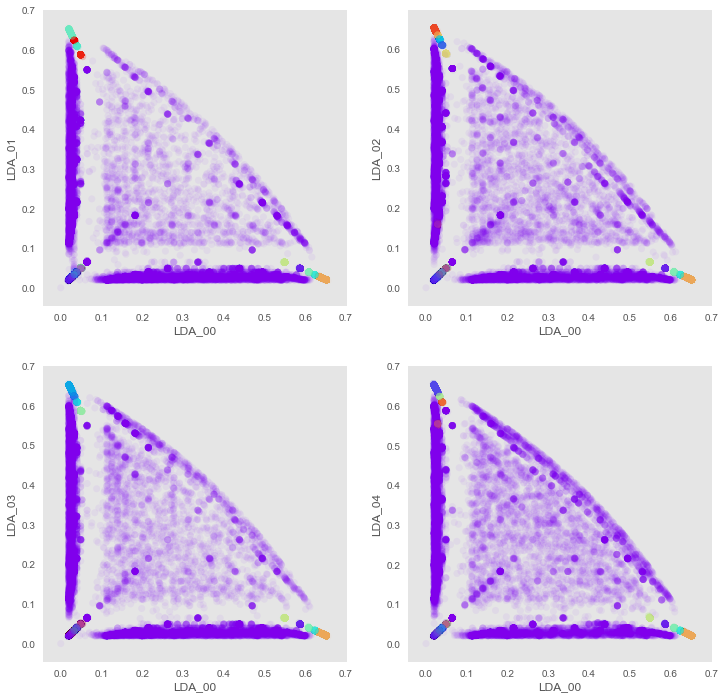

eps, min_pts =  0.0075 160


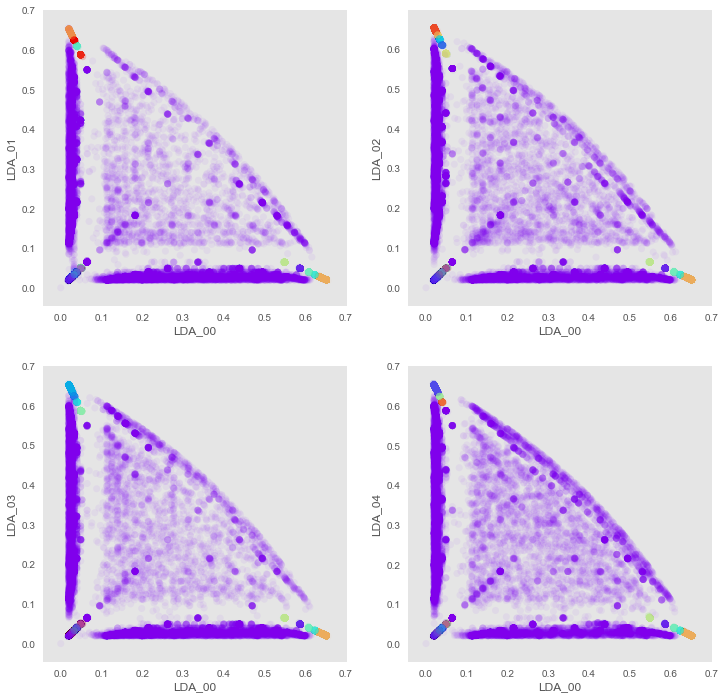

eps, min_pts =  0.0075 180


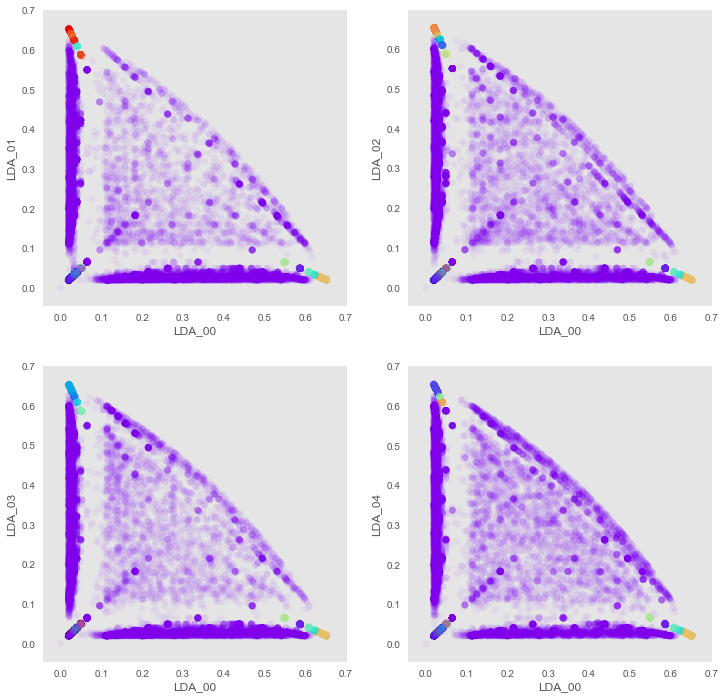

eps, min_pts =  0.01 20


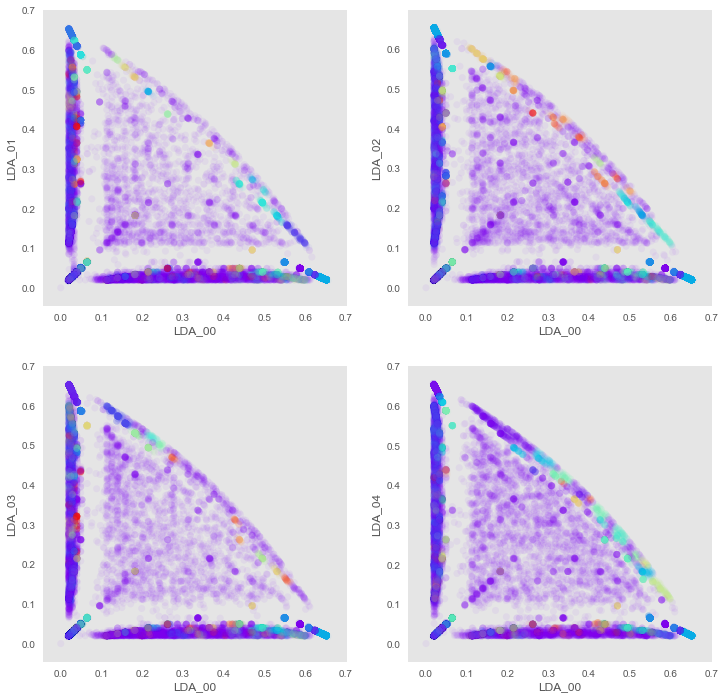

eps, min_pts =  0.01 40


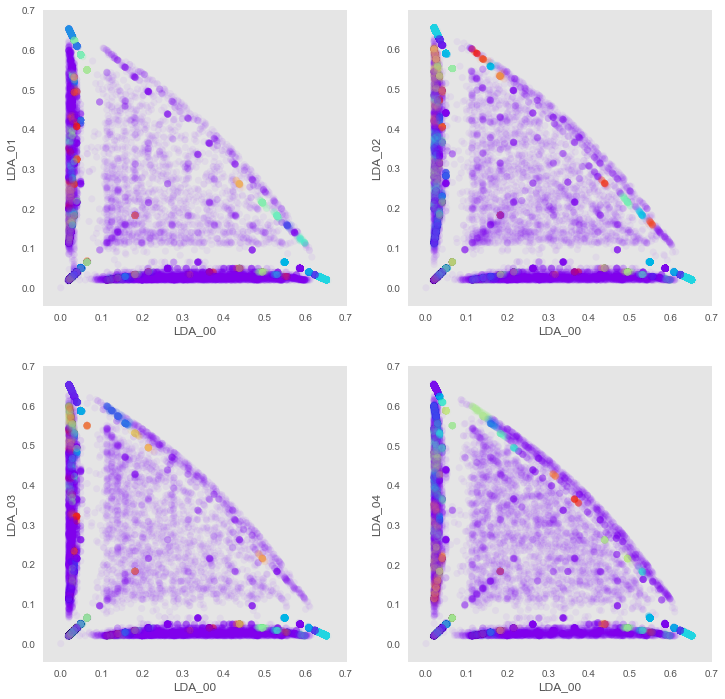

eps, min_pts =  0.01 60


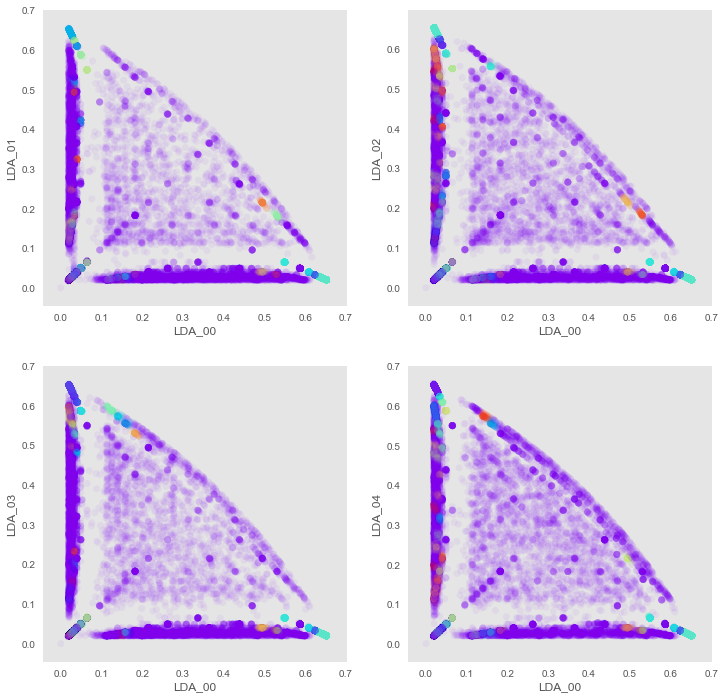

eps, min_pts =  0.01 80


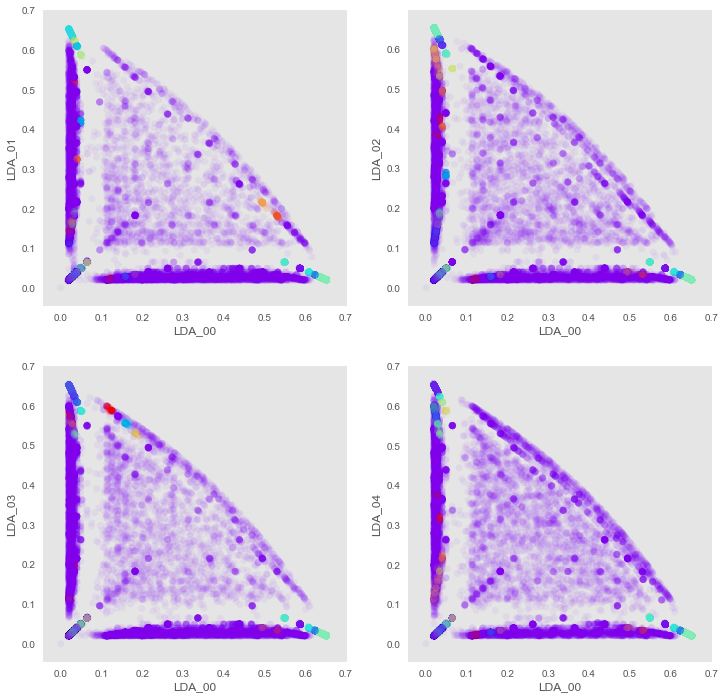

eps, min_pts =  0.01 100


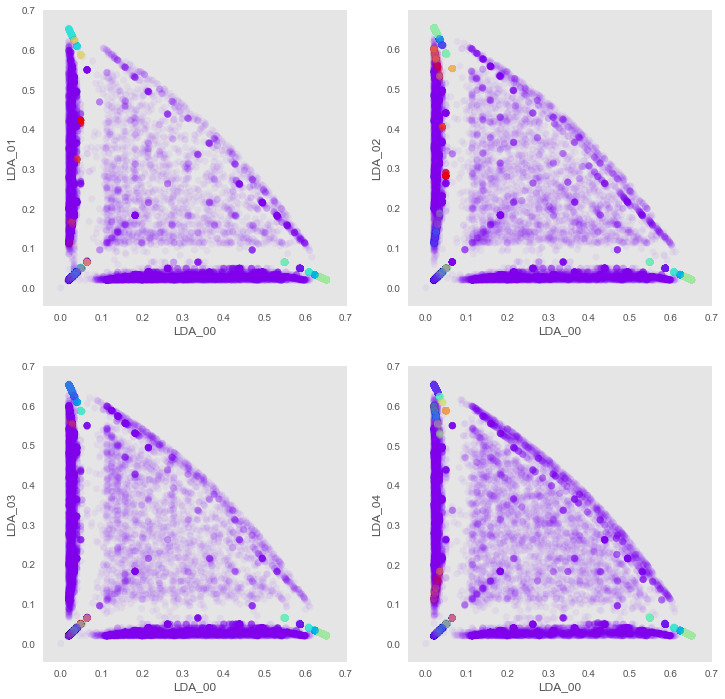

eps, min_pts =  0.01 120


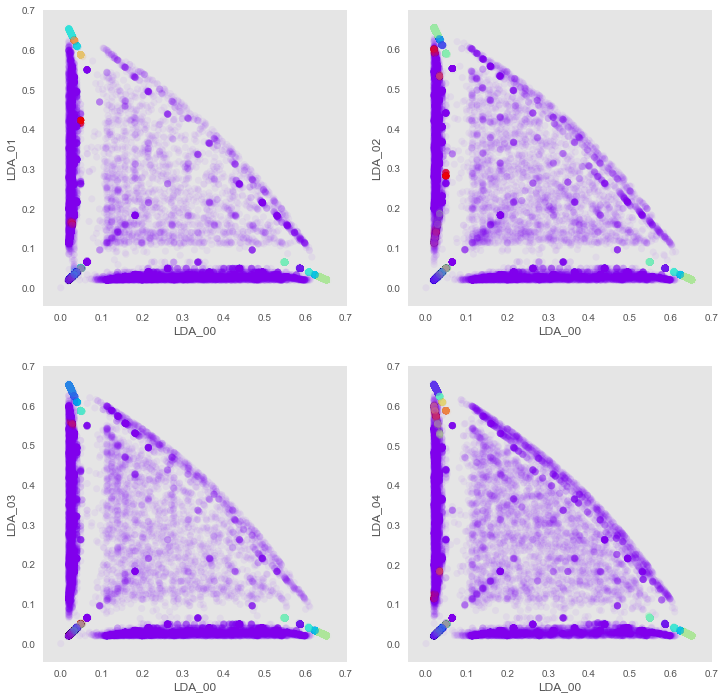

eps, min_pts =  0.01 140


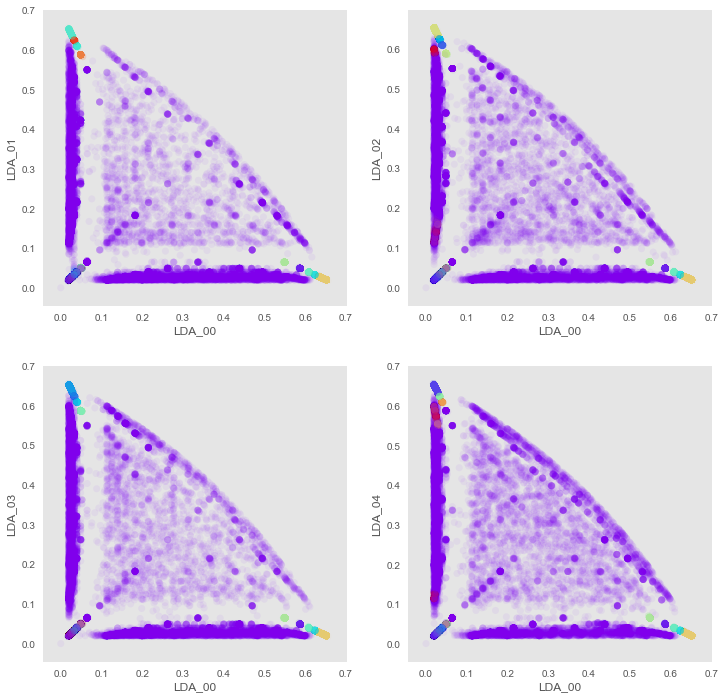

eps, min_pts =  0.01 160


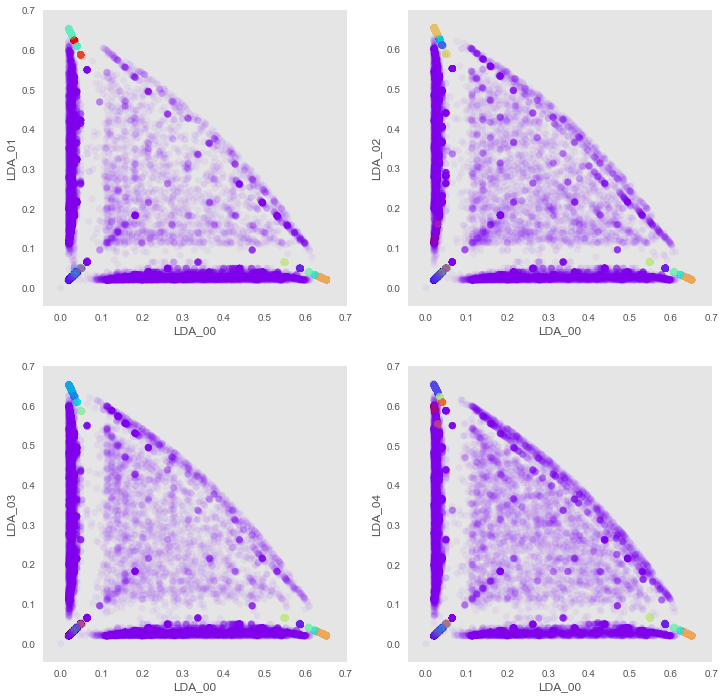

eps, min_pts =  0.01 180


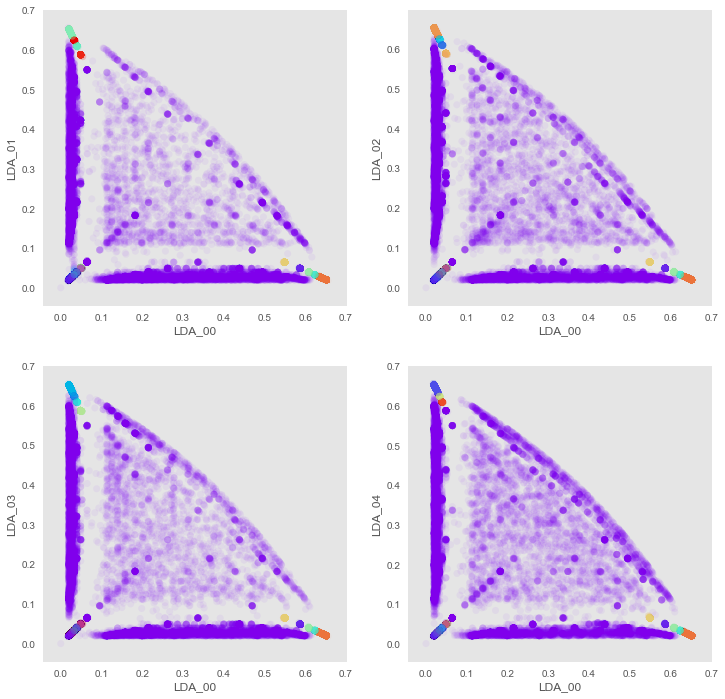

eps, min_pts =  0.02 20


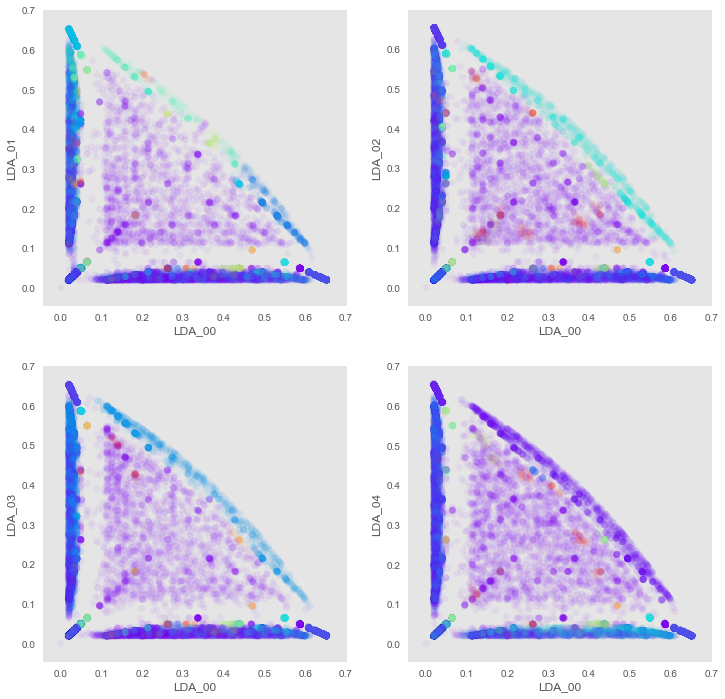

eps, min_pts =  0.02 40


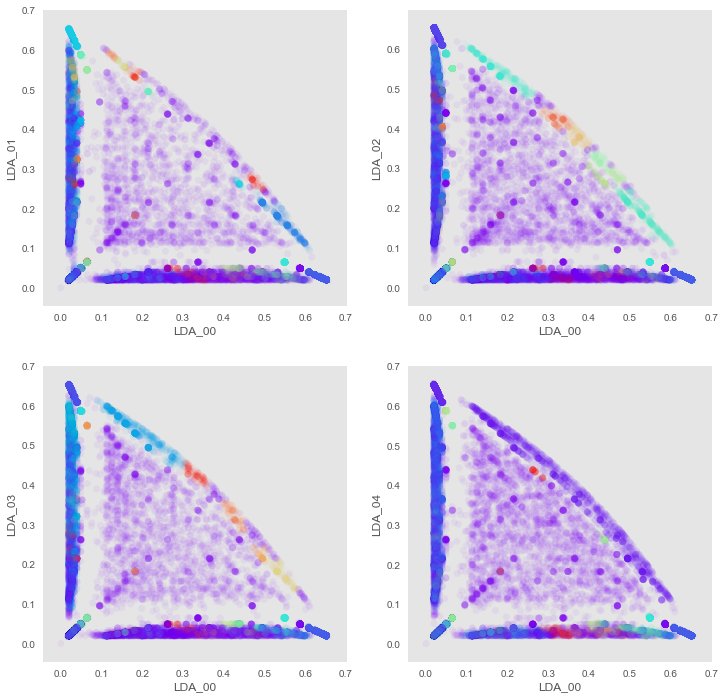

eps, min_pts =  0.02 60


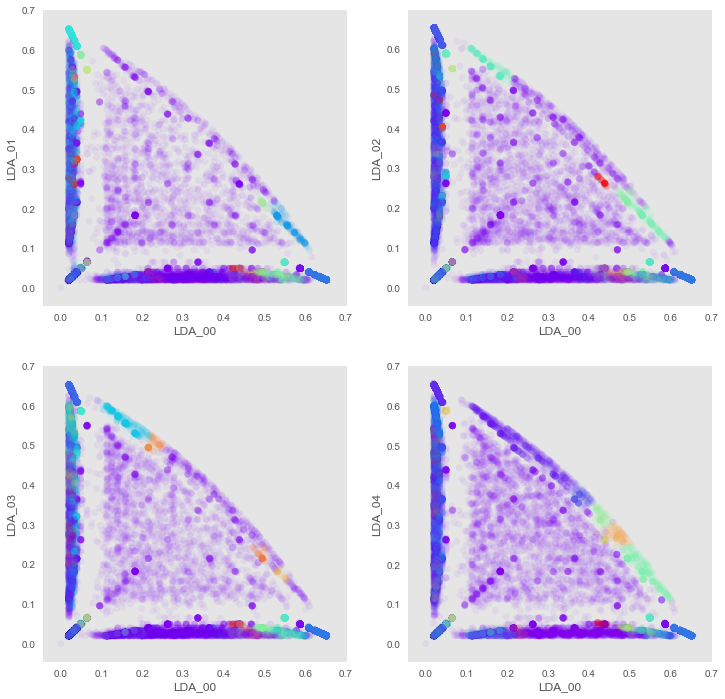

eps, min_pts =  0.02 80


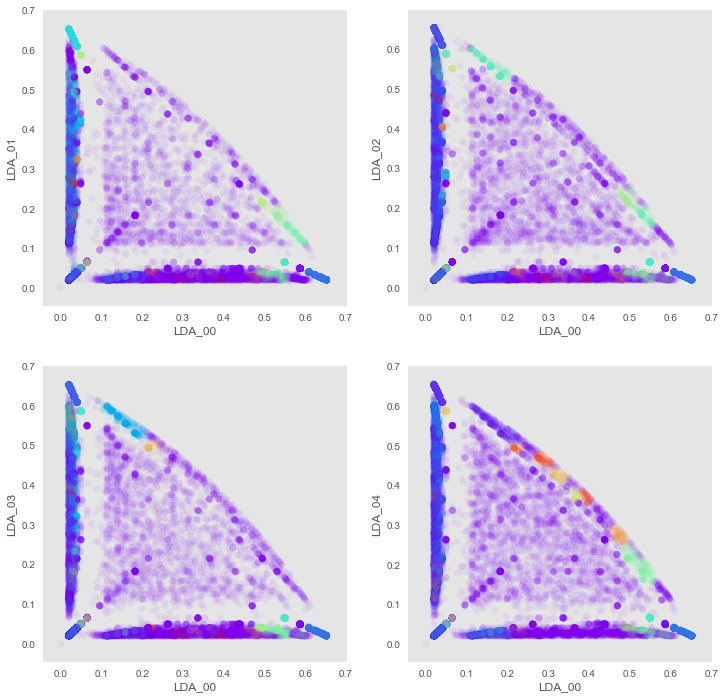

eps, min_pts =  0.02 100


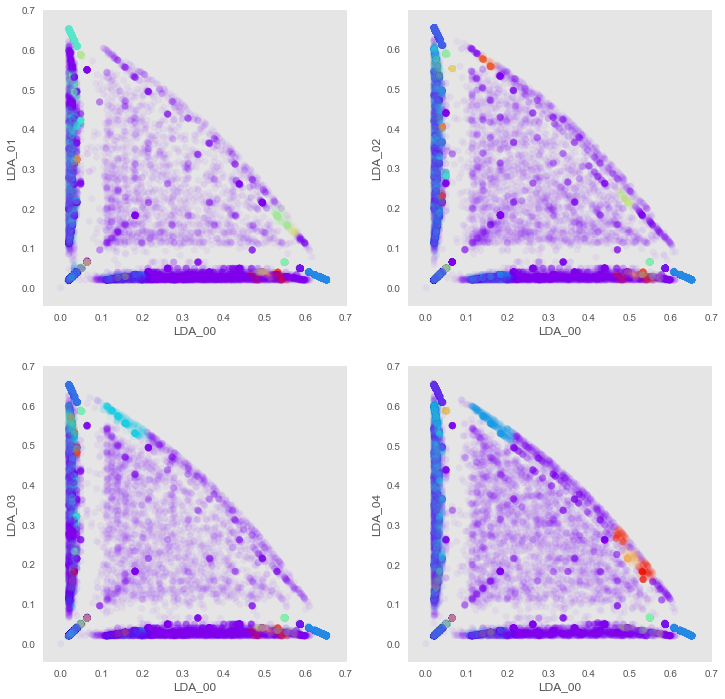

eps, min_pts =  0.02 120


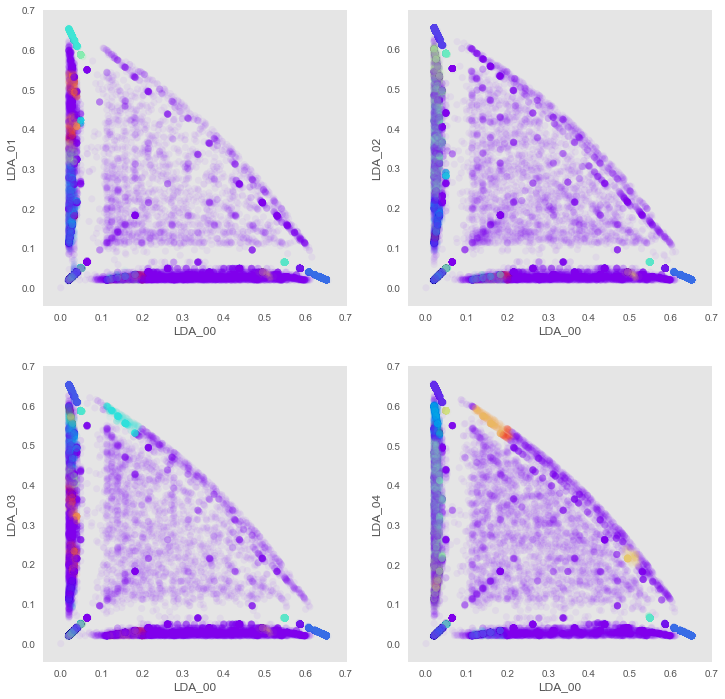

eps, min_pts =  0.02 140


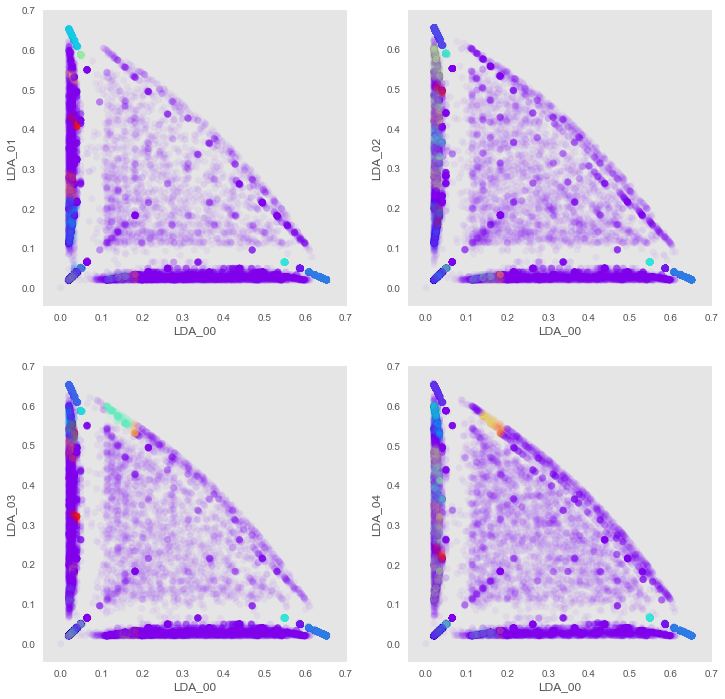

eps, min_pts =  0.02 160


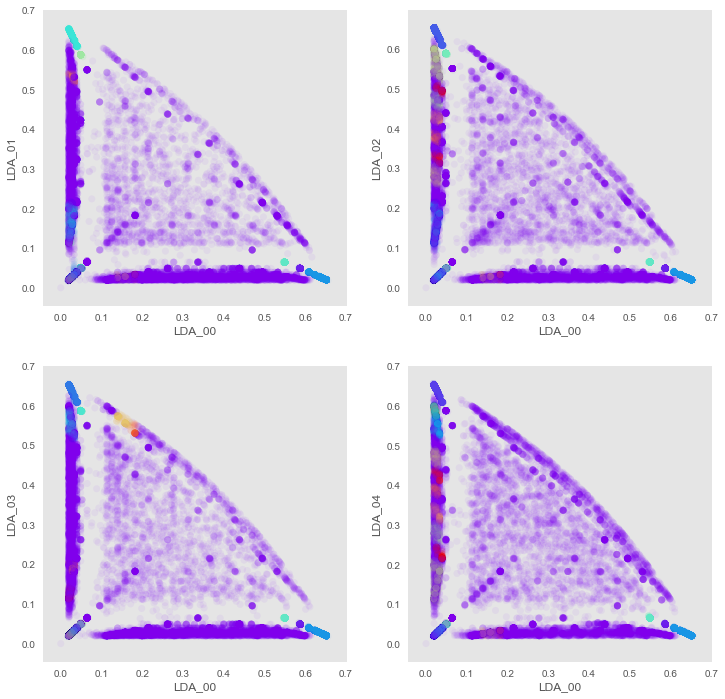

eps, min_pts =  0.02 180


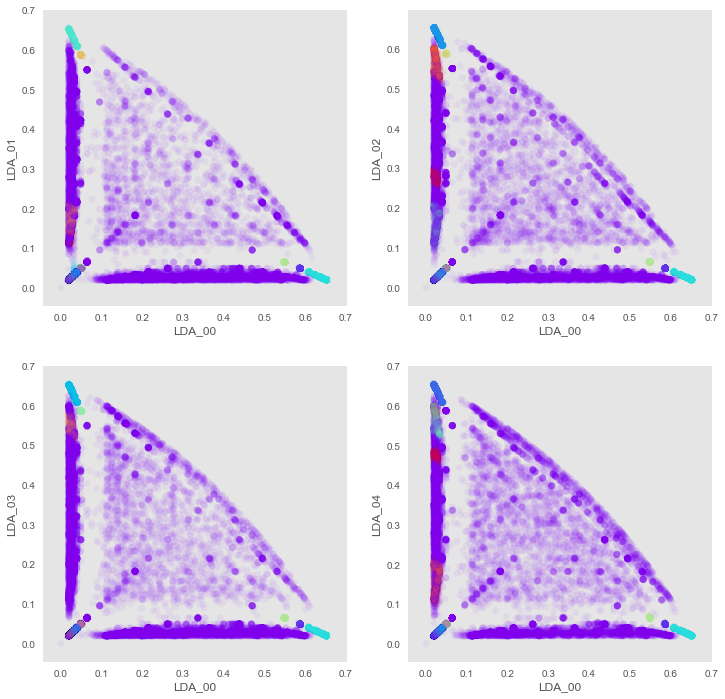

eps, min_pts =  0.05 20


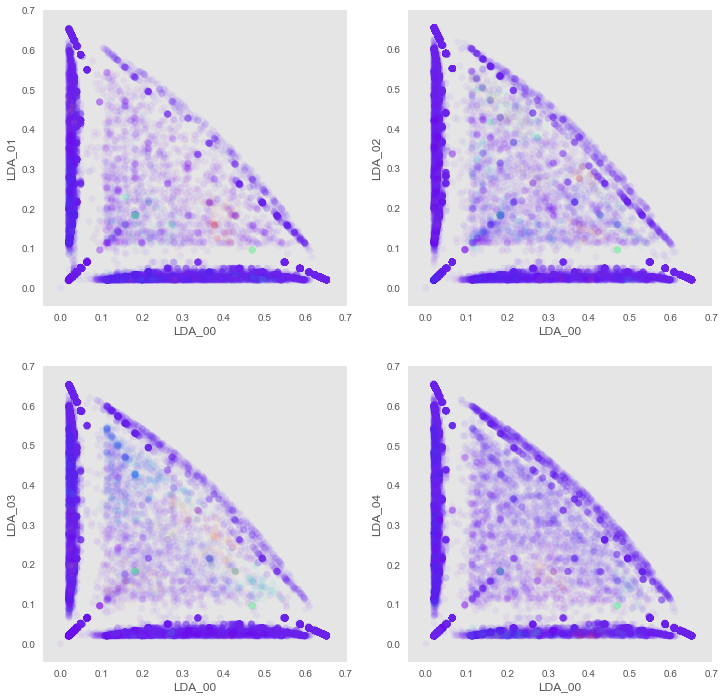

eps, min_pts =  0.05 40


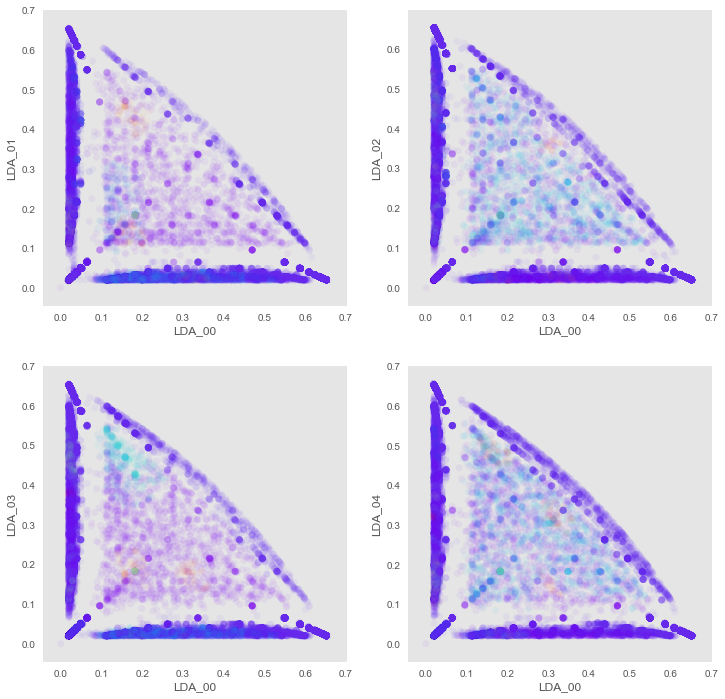

eps, min_pts =  0.05 60


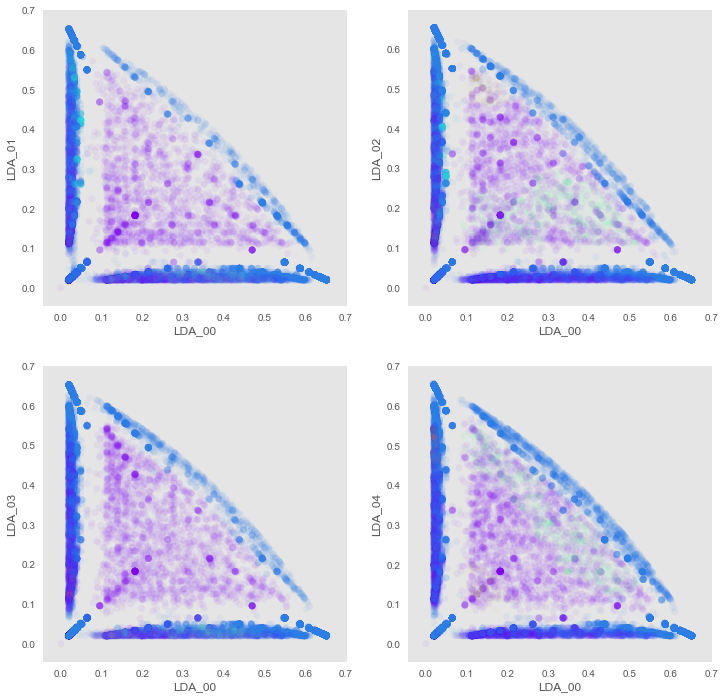

eps, min_pts =  0.05 80


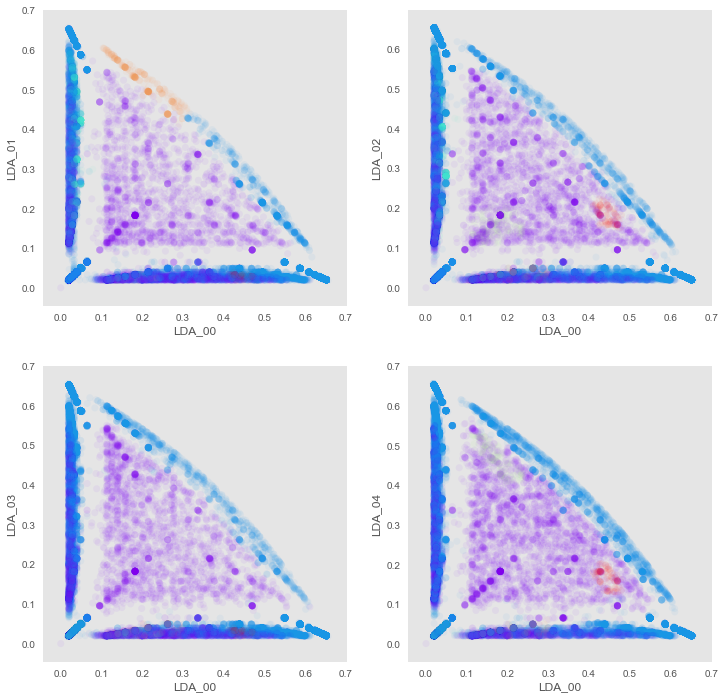

eps, min_pts =  0.05 100


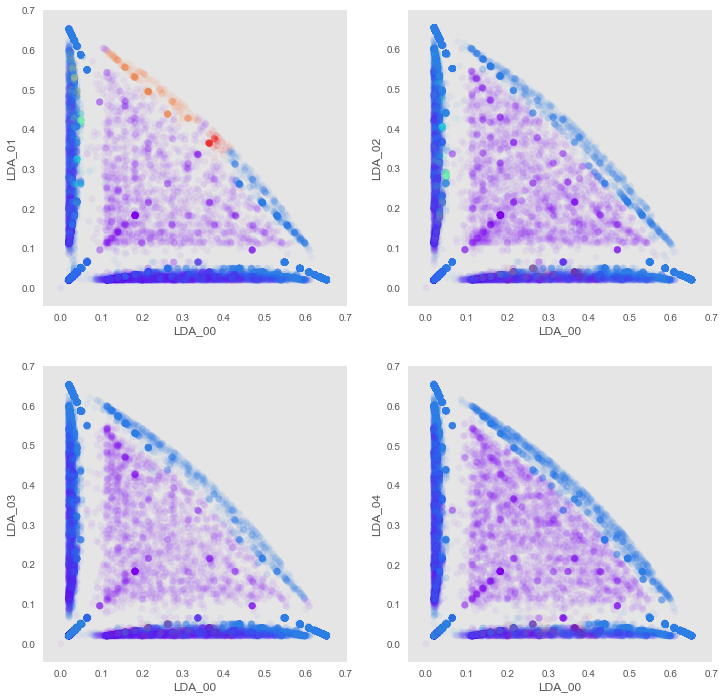

eps, min_pts =  0.05 120


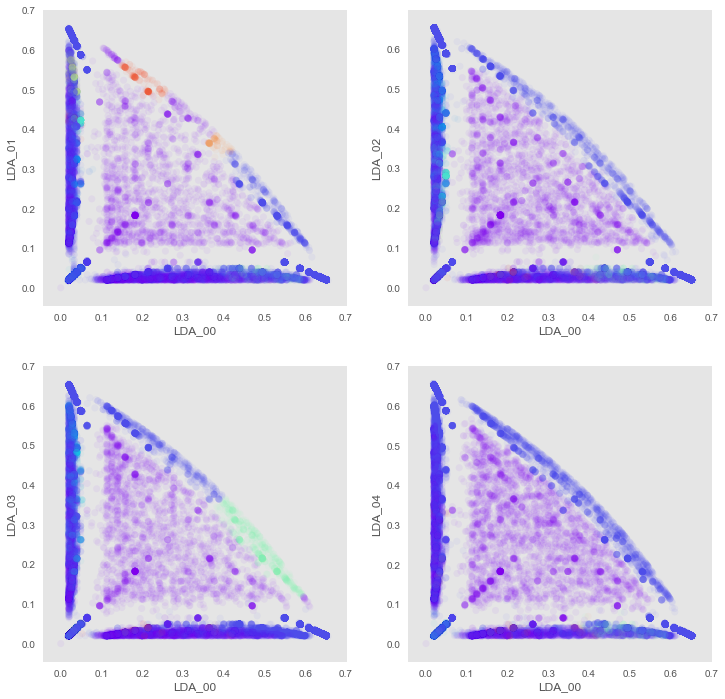

eps, min_pts =  0.05 140


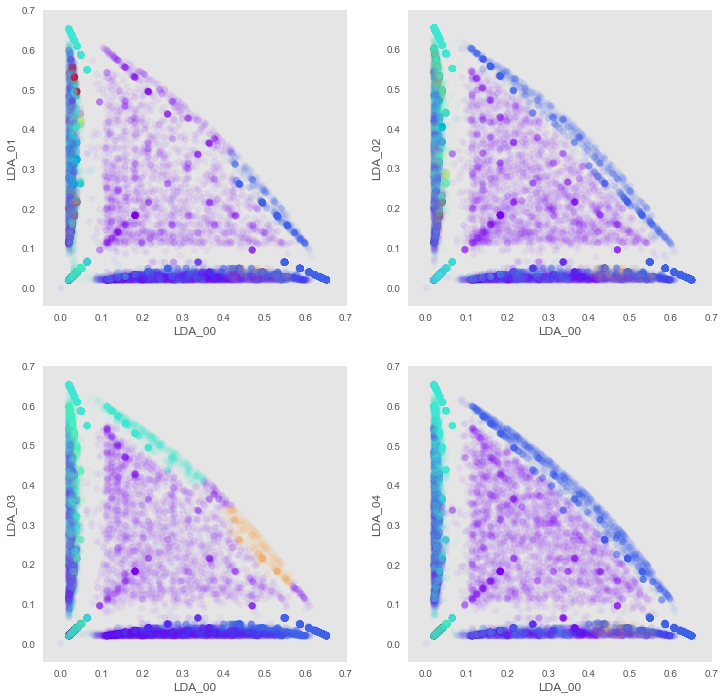

eps, min_pts =  0.05 160


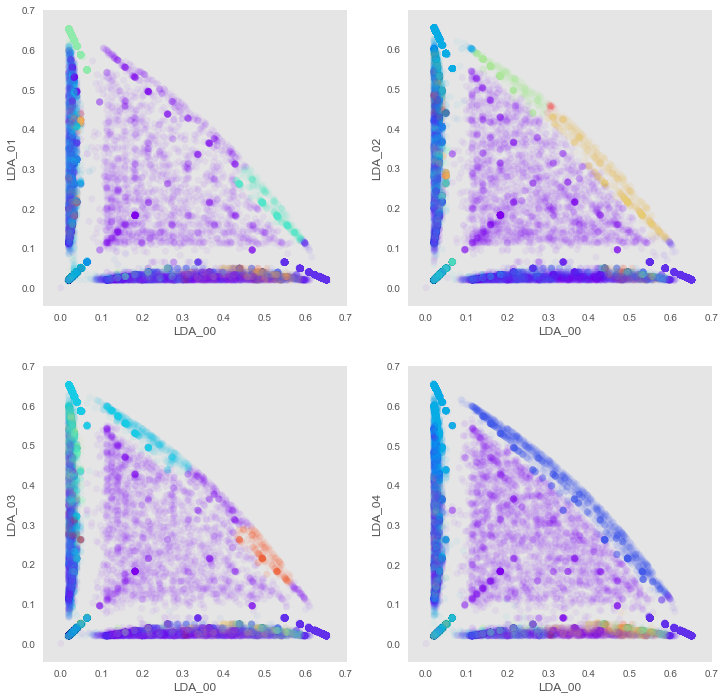

eps, min_pts =  0.05 180


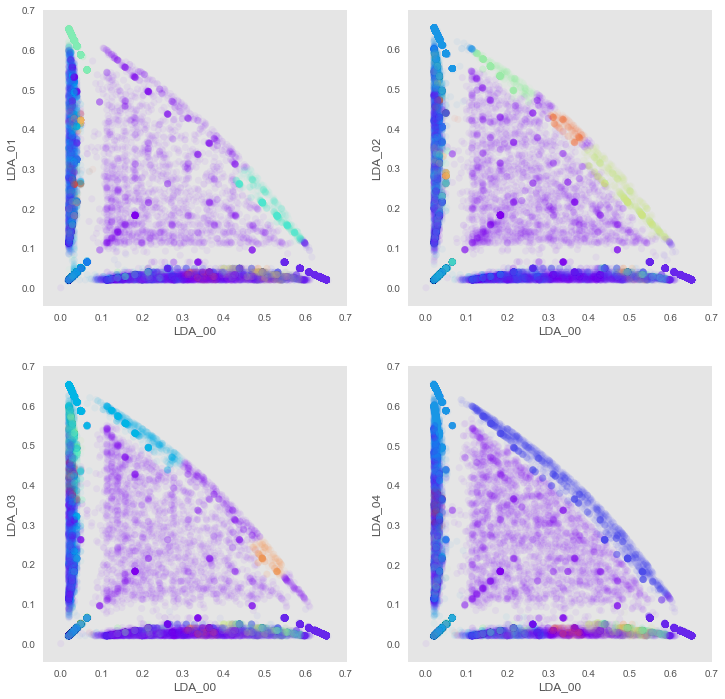

eps, min_pts =  0.1 20


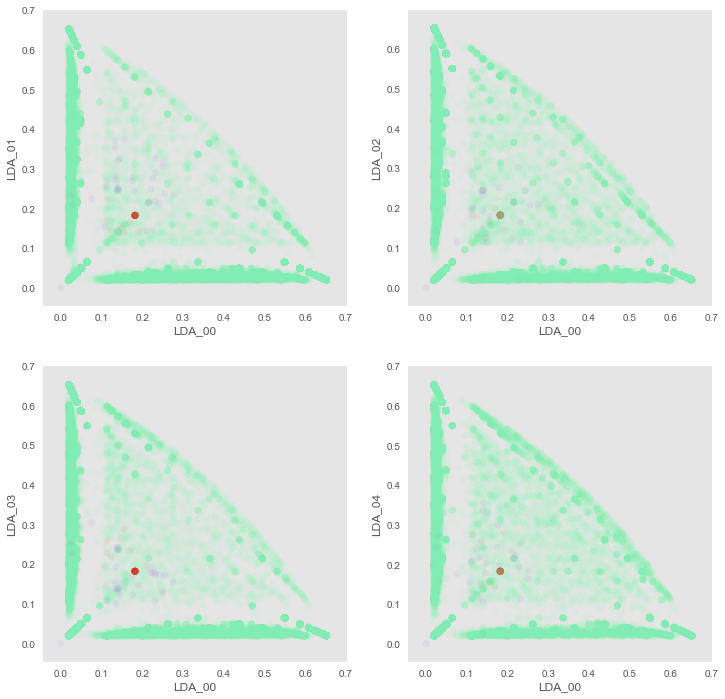

eps, min_pts =  0.1 40


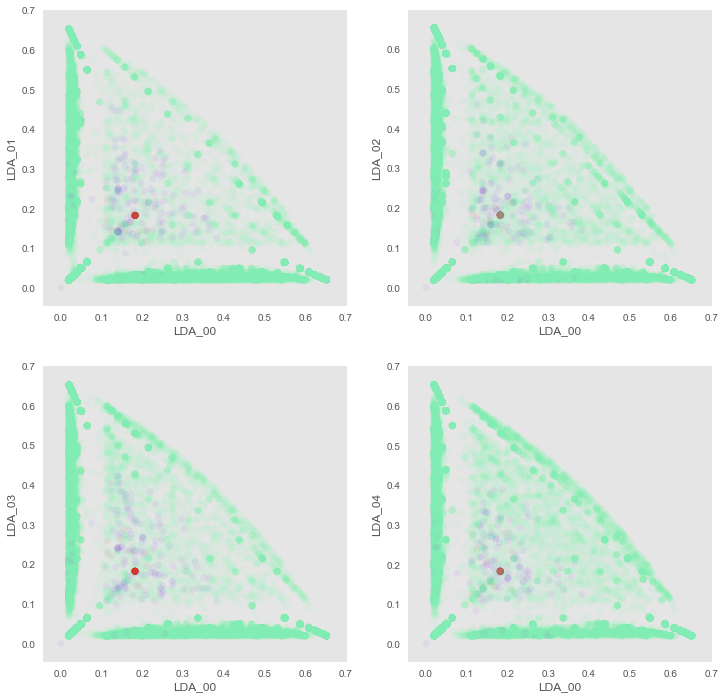

eps, min_pts =  0.1 60


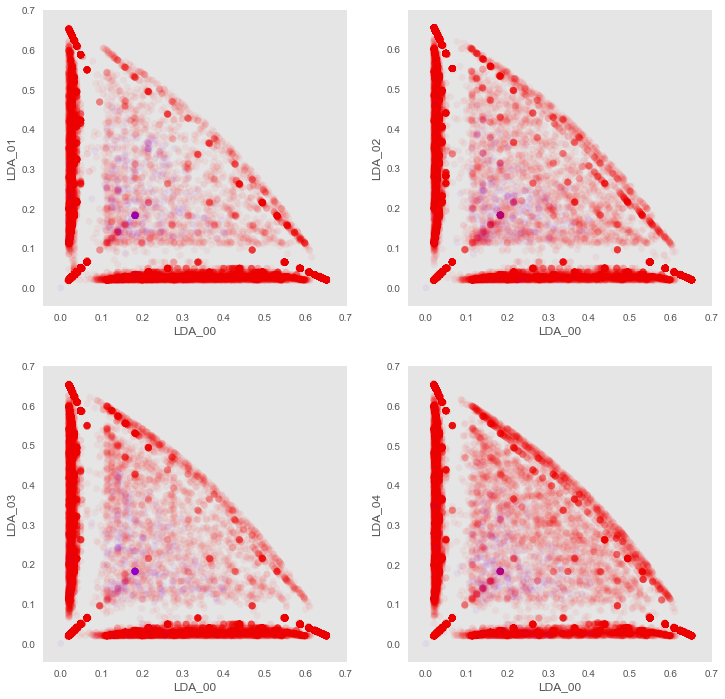

eps, min_pts =  0.1 80


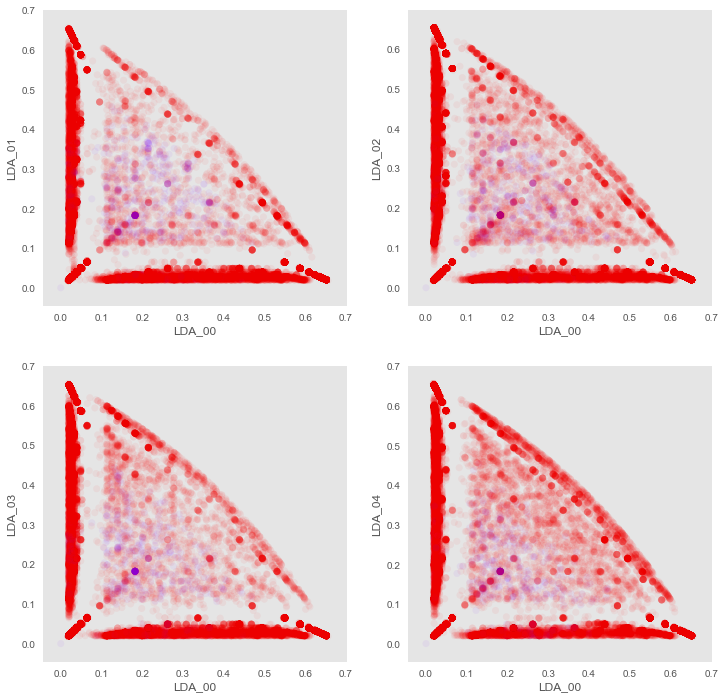

eps, min_pts =  0.1 100


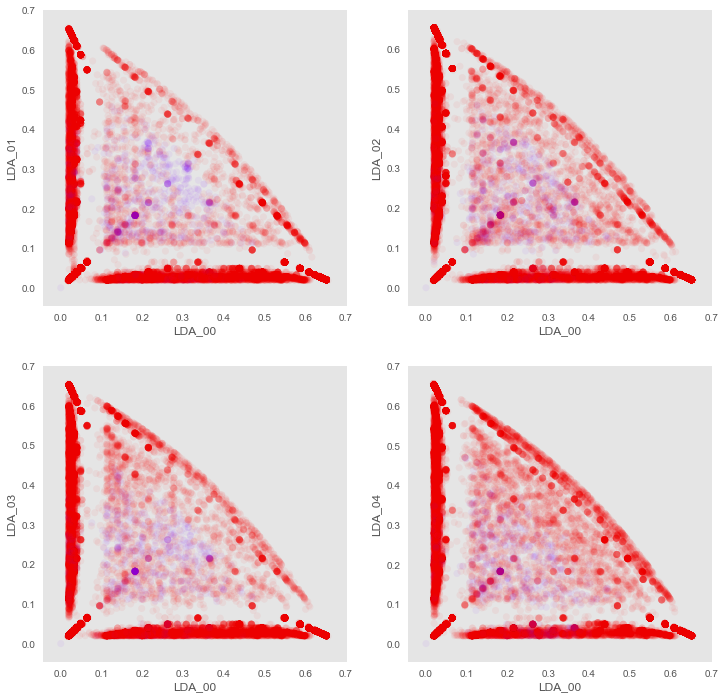

eps, min_pts =  0.1 120


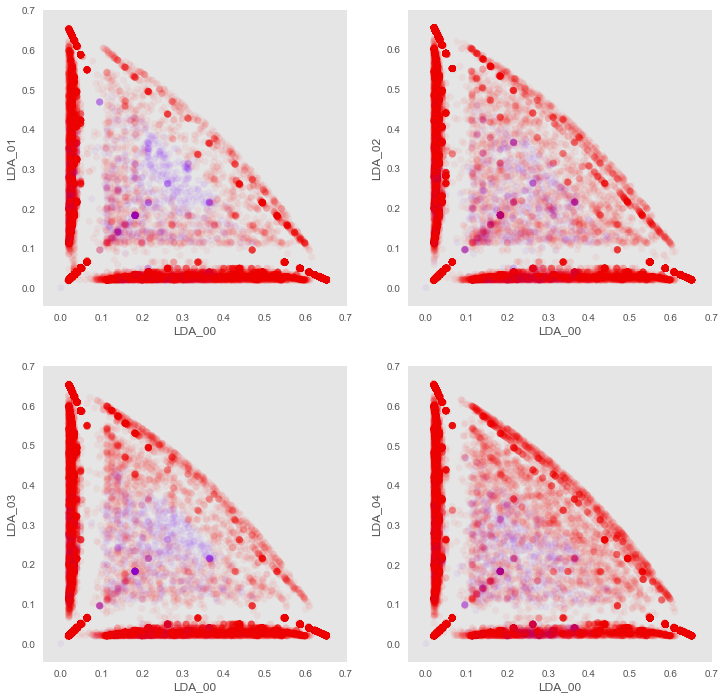

eps, min_pts =  0.1 140


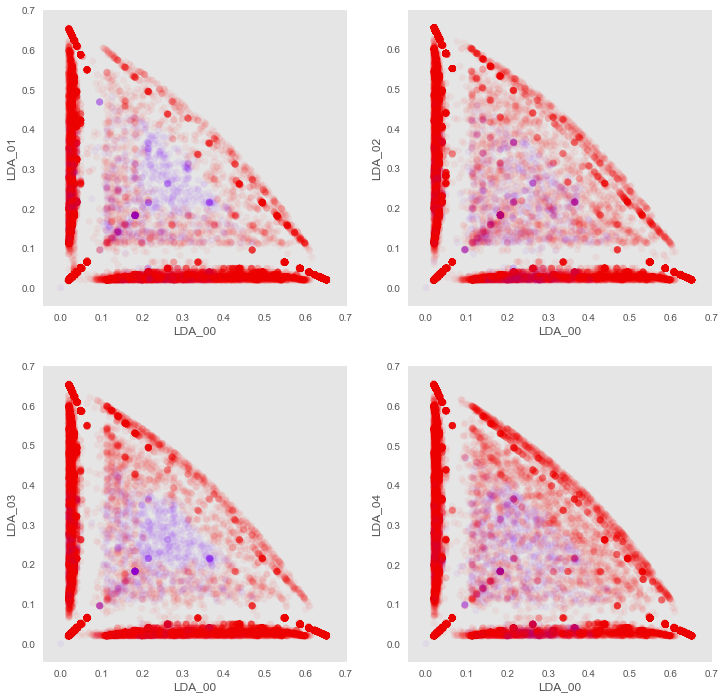

eps, min_pts =  0.1 160


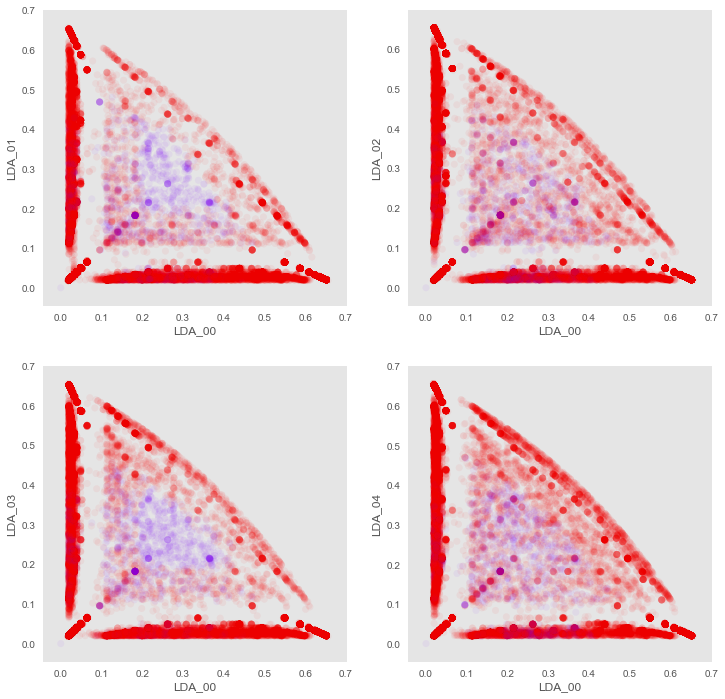

eps, min_pts =  0.1 180


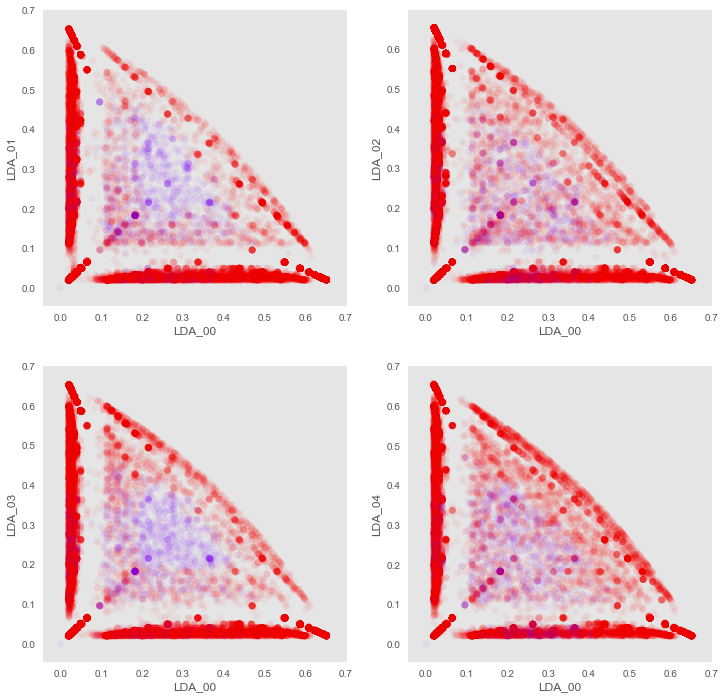

CPU times: user 5min 3s, sys: 4.69 s, total: 5min 8s
Wall time: 5min 3s


In [36]:
%%time 

from sklearn.cluster import DBSCAN

params = []
for eps in [0.005, 0.0075, 0.010, 0.020, 0.05, 0.10]:
    for min_pts in range (20, 200, 20):
        
        X1 = df[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]

        # append on the clustering
        
        cls_fam = DBSCAN(eps = eps, min_samples = min_pts)
        cls_fam.fit(X1)
        
        X1.describe().T
        
        newfeature_dbscan = cls_fam.labels_ # the labels from kmeans clustering
       
        print ("eps, min_pts = ", eps, min_pts)
        
        plt.figure(figsize=(12, 12))
        plt.subplot(221)
        X1 = X1.values
        plt.scatter(X1[:, 0], X1[:, 1],
                    c = newfeature_dbscan,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_01')
        plt.grid()

        plt.subplot(222)
        plt.scatter(X1[:, 0], X1[:, 2],
                    c = newfeature_dbscan,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_02')
        plt.grid()

        plt.subplot(223)
        plt.scatter(X1[:, 0], X1[:, 3],
                    c = newfeature_dbscan,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_03')
        plt.grid()

        plt.subplot(224)
        plt.scatter(X1[:, 0], X1[:, 4],
                    c = newfeature_dbscan,
                    cmap = plt.cm.rainbow,
                    s = 50,
                    linewidths = 0,
                    alpha = 0.05)
        plt.xlabel('LDA_00'), plt.ylabel('LDA_04')
        plt.grid()

        plt.show();
        
#        y = df_imputed['Survived']
#        X = df_imputed[['IsMale','Pclass','Fare']]
#        X = np.column_stack((X,pd.get_dummies(newfeature_fam)))

#        acc = cross_val_score(clf,X,y=y,cv=cv)
#        params.append((n_fare,n_fam,acc.mean()*100,acc.std()*100)) # save state

#        print (eps,mpts,"Average accuracy = ", acc.mean()*100, "+-", acc.std()*100)
 

### Spectral Clustering  


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:234: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


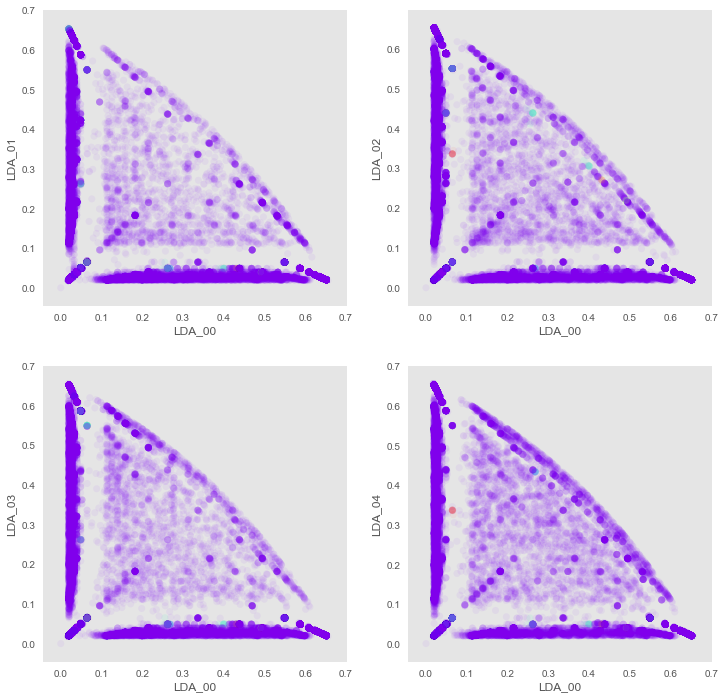

In [38]:
from sklearn.cluster import SpectralClustering

X1 = df[['ln_LDA_00','ln_LDA_01', 'ln_LDA_02', 'ln_LDA_03', 'ln_LDA_04']]

nclust = 6

# If a string, this may be one of 
#  ‘nearest_neighbors’, ‘precomputed’, ‘rbf’ 
#  or one of the kernels supported by sklearn.metrics.pairwise_kernels

spc = SpectralClustering(n_clusters = nclust, affinity = 'nearest_neighbors')

labels = spc.fit_predict(X1)

plt.figure(figsize=(12, 12))
plt.subplot(221)
X1 = X1.values
plt.scatter(X1[:, 0], X1[:, 1],
            c = labels,
            cmap = plt.cm.rainbow,
            s = 50,
            linewidths = 0,
            alpha = 0.05)
plt.xlabel('LDA_00'), plt.ylabel('LDA_01');
plt.grid()

plt.subplot(222)
plt.scatter(X1[:, 0], X1[:, 2],
            c = labels,
            cmap = plt.cm.rainbow,
            s = 50,
            linewidths = 0,
            alpha = 0.05)
plt.xlabel('LDA_00'), plt.ylabel('LDA_02');
plt.grid()

plt.subplot(223)
plt.scatter(X1[:, 0], X1[:, 3],
            c = labels,
            cmap = plt.cm.rainbow,
            s = 50,
            linewidths = 0,
            alpha = 0.05)
plt.xlabel('LDA_00'), plt.ylabel('LDA_03')
plt.grid()

plt.subplot(224)
plt.scatter(X1[:, 0], X1[:, 4],
            c = labels,
            cmap = plt.cm.rainbow,
            s = 50,
            linewidths = 0,
            alpha = 0.05)
plt.xlabel('LDA_00'), plt.ylabel('LDA_04')
plt.grid()

plt.show();

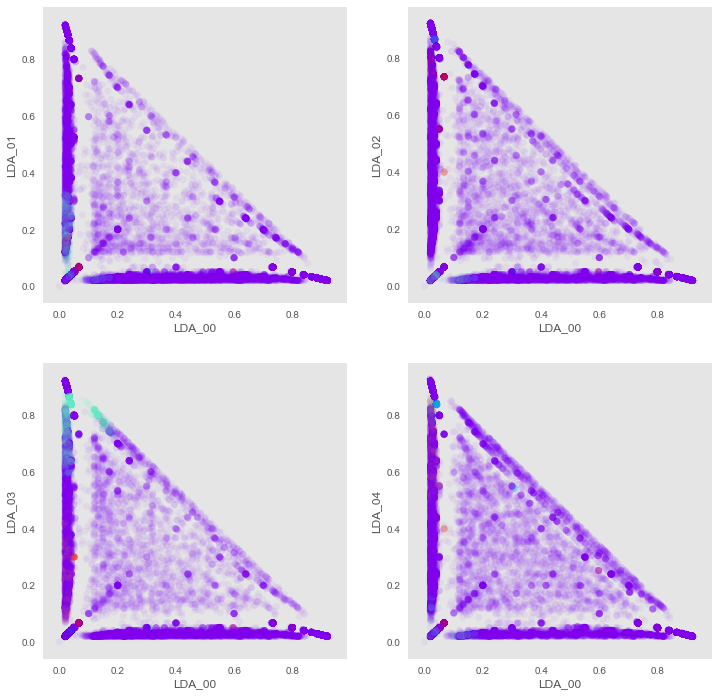